In [54]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'
%qtconsole
%load_ext snakeviz

The snakeviz extension is already loaded. To reload it, use:
  %reload_ext snakeviz


In [2]:
import pandas as pd
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors

import logging
logging.basicConfig(level=logging.INFO)

In [3]:
from logging import getLogger

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

from loren_frank_data_processing import (get_interpolated_position_dataframe,
                                         get_LFPs,
                                         get_multiunit_indicator_dataframe,
                                         get_spike_indicator_dataframe,
                                         get_trial_time, make_neuron_dataframe,
                                         make_tetrode_dataframe)
from replay_identification import ReplayDetector
from replay_identification.lfp_likelihood import estimate_ripple_band_power
from ripple_detection import Kay_ripple_detector
from ripple_detection.core import segment_boolean_series
from sklearn.neighbors import KernelDensity

_BRAIN_AREAS = 'CA1'
_MARKS = ['channel_1_max', 'channel_2_max', 'channel_3_max',
          'channel_4_max']

logger = getLogger(__name__)


def detect_epoch_ripples(epoch_key, animals, sampling_frequency,
                         brain_areas=_BRAIN_AREAS,
                         minimum_duration=pd.Timedelta(milliseconds=15),
                         zscore_threshold=3, speed=None):
    '''Returns a list of tuples containing the start and end times of
    ripples. Candidate ripples are computed via the ripple detection
    function and then filtered to exclude ripples where the animal was
    still moving.
    '''

    tetrode_info = make_tetrode_dataframe(animals).xs(
        epoch_key, drop_level=False)
    brain_areas = [brain_areas] if isinstance(
        brain_areas, str) else brain_areas
    is_brain_areas = tetrode_info.area.isin(brain_areas)
    if 'CA1' in brain_areas:
        is_brain_areas = is_brain_areas & tetrode_info.validripple
    tetrode_keys = tetrode_info[is_brain_areas].index
    lfps = get_LFPs(tetrode_keys, animals)
    time = lfps.index
    if speed is None:
        speed = get_interpolated_position_dataframe(
            epoch_key, animals).speed

    return Kay_ripple_detector(
        time, lfps.values, speed.values, sampling_frequency,
        minimum_duration=minimum_duration, zscore_threshold=zscore_threshold)


def get_ripple_indicator(epoch_key, animals, ripple_times, position_info):
    time = get_trial_time(epoch_key, animals)
    ripple_indicator = pd.Series(np.zeros_like(time, dtype=bool), index=time)
    for _, start_time, end_time in ripple_times.itertuples():
        if position_info.loc[start_time:end_time].speed.max() <= 4:
            ripple_indicator.loc[start_time:end_time] = True

    return ripple_indicator


def get_ripple_power(epoch_key, animals, sampling_frequency):
    tetrode_info = make_tetrode_dataframe(animals).xs(
        epoch_key, drop_level=False)
    is_brain_areas = tetrode_info.area.isin(['CA1'])
    is_brain_areas = is_brain_areas & tetrode_info.validripple
    tetrode_keys = tetrode_info[is_brain_areas].index
    lfps = get_LFPs(tetrode_keys, animals)
    return estimate_ripple_band_power(lfps.values, sampling_frequency)


def get_spikes(epoch_key, animals):
    neuron_info = make_neuron_dataframe(animals).xs(
        epoch_key, drop_level=False)
    neuron_info = neuron_info[
        neuron_info.area.isin(['CA1', 'CA3']) &
        (neuron_info.meanrate > 0.1)]
    return np.stack([get_spike_indicator_dataframe(neuron_key, animals).values
                     for neuron_key in neuron_info.index], axis=-1)


def get_multiunit(epoch_key, animals, marks=_MARKS):
    tetrode_info = make_tetrode_dataframe(animals).xs(
        epoch_key, drop_level=False)
    is_brain_areas = (tetrode_info.area.isin(['CA1', 'CA3'])
                      & (tetrode_info.numcells > 0))
    tetrode_keys = tetrode_info[is_brain_areas].index

    return np.stack([get_multiunit_indicator_dataframe(tetrode_key, animals)
                     .loc[:, marks]
                     for tetrode_key in tetrode_keys], axis=-1)

In [4]:
from collections import namedtuple
from os.path import join, abspath, dirname, pardir

# LFP sampling frequency
sampling_frequency = 1500

# Data directories and definitions
NOTEBOOK_DIR = !pwd
ROOT_DIR = abspath(dirname(NOTEBOOK_DIR[0]))
RAW_DATA_DIR = join(ROOT_DIR, 'Raw-Data')

Animal = namedtuple('Animal', {'directory', 'short_name'})
animals = {
    'bon': Animal(directory=join(RAW_DATA_DIR, 'Bond'),
                  short_name='bon'),
}

epoch_key = ('bon', 4, 2)

In [5]:
position_info = get_interpolated_position_dataframe(epoch_key, animals)
speed = position_info.speed
linear_distance = position_info.linear_distance.values
time = position_info.index

power = get_ripple_power(epoch_key, animals, sampling_frequency)
spikes = get_spikes(epoch_key, animals)
multiunit = get_multiunit(epoch_key, animals)
ripple_times = detect_epoch_ripples(epoch_key, animals, sampling_frequency,
                                    speed=speed)
is_ripple = get_ripple_indicator(
    epoch_key, animals, ripple_times, position_info)


INFO:spectral_connectivity.transforms:Multitaper(sampling_frequency=1500, time_halfbandwidth_product=1,
           time_window_duration=0.02, time_window_step=0.0006666666666666666,
           detrend_type='constant', start_time=0, n_tapers=1)


In [46]:
from sklearn.neighbors import KernelDensity
detector = ReplayDetector(
    replay_speed=16,
    multiunit_density_model=KernelDensity,
    multiunit_model_kwargs=dict(bandwidth=10, leaf_size=100000, rtol=1E-1))
detector.fit(
    is_ripple, speed.values, linear_distance, power, spikes, multiunit)

INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting LFP power model...
INFO:replay_identification.decoders:Fitting spiking model...
neurons: 100%|██████████| 31/31 [02:26<00:00,  4.72s/it]
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:05<00:00,  3.10it/s]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...


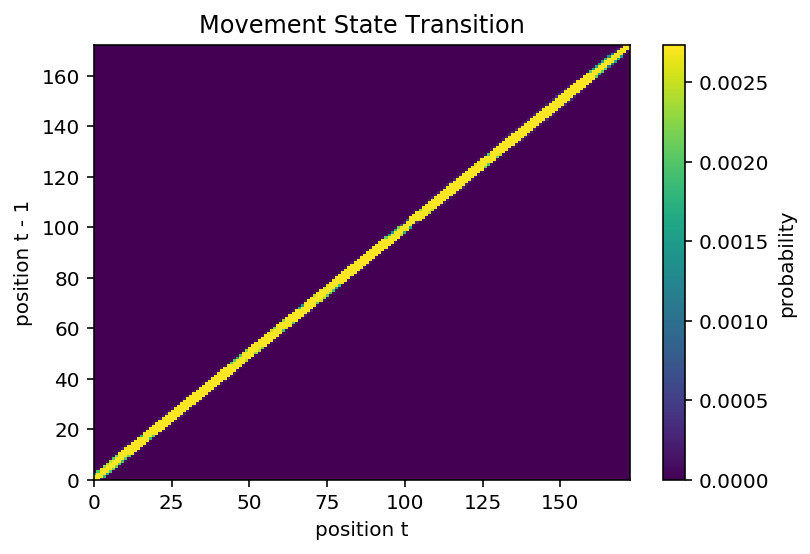

In [7]:
detector.plot_movement_state_transition()

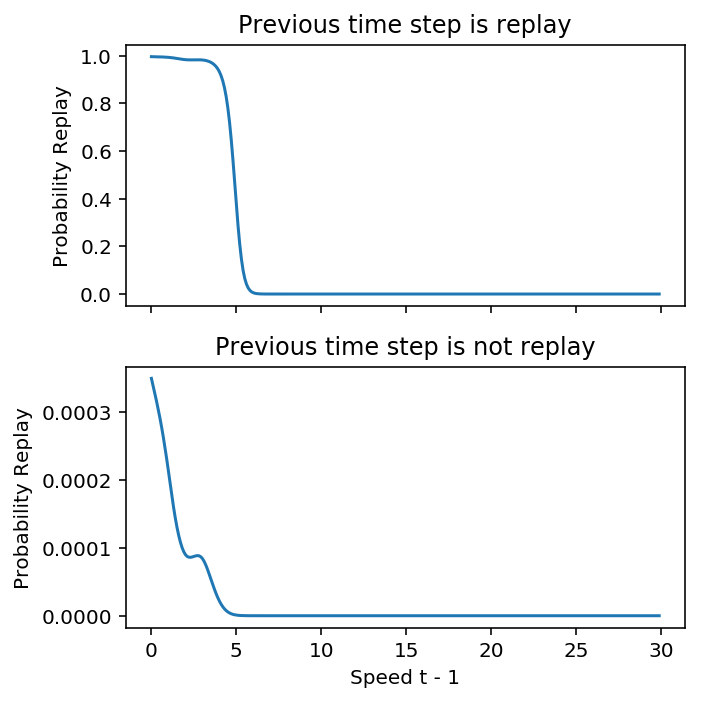

In [8]:
detector.plot_replay_state_transition()

INFO:replay_identification.decoders:Predicting spikes likelihood...
100%|██████████| 31/31 [03:04<00:00,  5.97s/it]
INFO:replay_identification.decoders:Predicting replay probability and density...


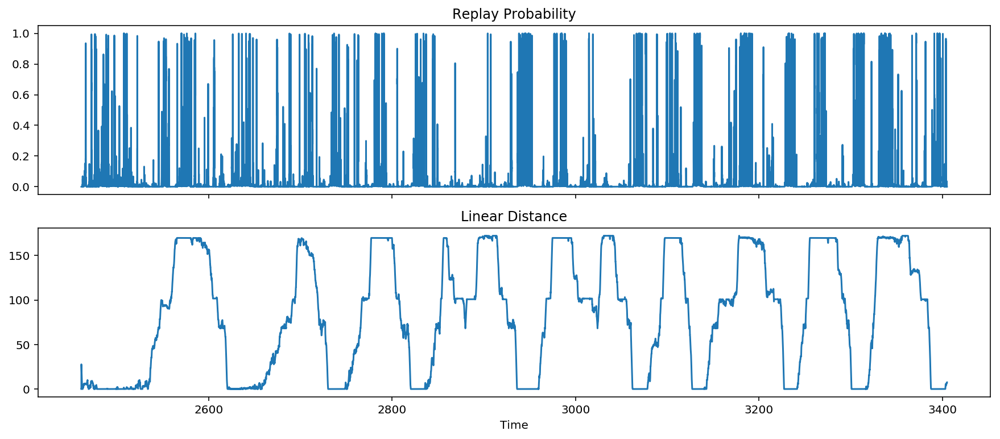

In [17]:
results_spikes = detector.predict(
    speed.values, linear_distance, spikes=spikes, time=time.total_seconds().values,
    use_likelihoods=['spikes'])

fig, axes = plt.subplots(2, 1, sharex=True, figsize=(15, 6))
axes[0].plot(results_spikes.time, results_spikes.replay_probability)
axes[0].set_title('Replay Probability')
axes[1].plot(results_spikes.time, linear_distance)
axes[1].set_title('Linear Distance')
axes[-1].set_xlabel('Time');

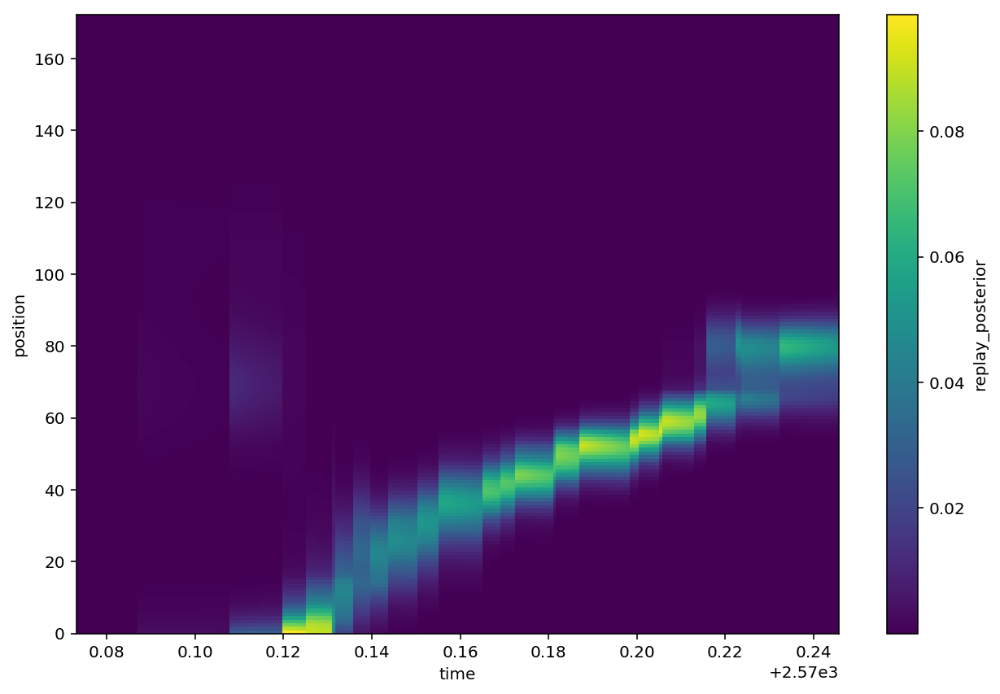

In [27]:
results_spikes.sel(time=slice(2570.073, 2570.246)).replay_posterior.plot(x='time', y='position', size=7)

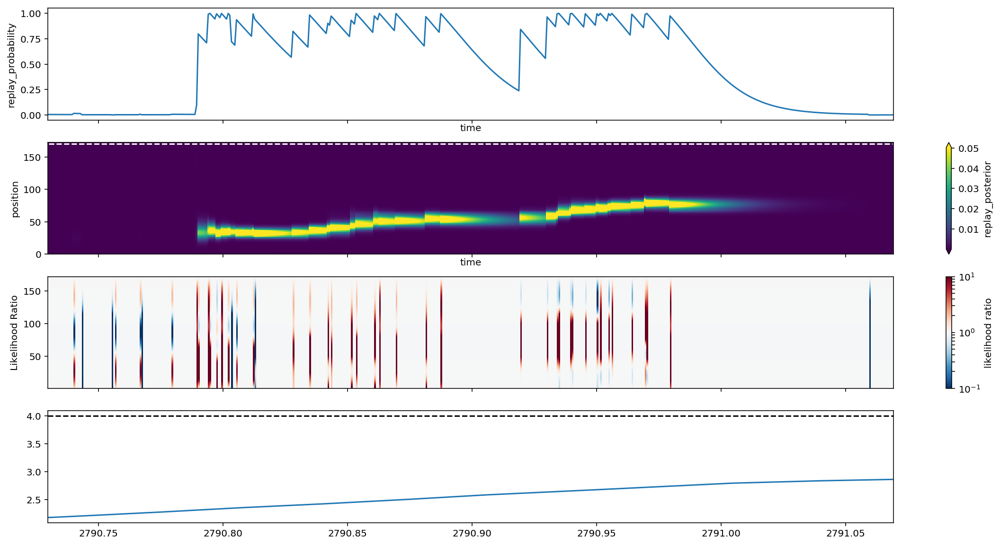

In [32]:
min_time, max_time = (2790.730 - 0.0), (2791.069 + 0.0)

ind = (results_spikes.time > min_time) & (results_spikes.time < max_time)

sm = plt.cm.ScalarMappable()
sm.set_array([])

fig, axes = plt.subplots(4, 1, figsize=(20, 10), sharex=True)

results_spikes.replay_probability.sel(time=slice(min_time, max_time)).plot(x='time', ax=axes[0])
plt.colorbar(sm, ax=axes[0]).ax.set_visible(False)
c = results_spikes.replay_posterior.sel(time=slice(min_time, max_time)).plot(x='time', y='position', robust=True, ax=axes[1])
axes[1].plot(results_spikes.time[ind], linear_distance[ind], linestyle='--', color='white');

likelihood = results_spikes.likelihood.sel(time=slice(min_time, max_time))
t, p = likelihood.time, likelihood.position
t, p = np.meshgrid(t, p)
cax = axes[2].pcolormesh(
    t, p, likelihood.values.T,
    norm=colors.LogNorm(1E-1, 1E1), cmap='RdBu_r')
axes[2].set_ylabel('Likelihood Ratio')
plt.colorbar(cax, ax=axes[2], label='likelihood ratio', orientation='vertical')

axes[3].plot(results_spikes.time[ind], speed.values[ind]);
axes[3].axhline(4, linestyle='--', color='black');
plt.colorbar(sm, ax=axes[3]).ax.set_visible(False)

In [53]:
results = detector.predict(
    speed.values, linear_distance, multiunit=multiunit, time=time.total_seconds().values,
    use_likelihoods=['multiunit'])

fig, axes = plt.subplots(2, 1, sharex=True, figsize=(15, 6))
axes[0].plot(results.time, results.replay_probability)
axes[0].set_title('Replay Probability')
axes[1].plot(results.time, linear_distance)
axes[1].set_title('Linear Distance')
axes[-1].set_xlabel('Time');

INFO:replay_identification.decoders:Predicting multiunit likelihood...
  0%|          | 0/18 [00:00<?, ?it/s]

KeyboardInterrupt: 

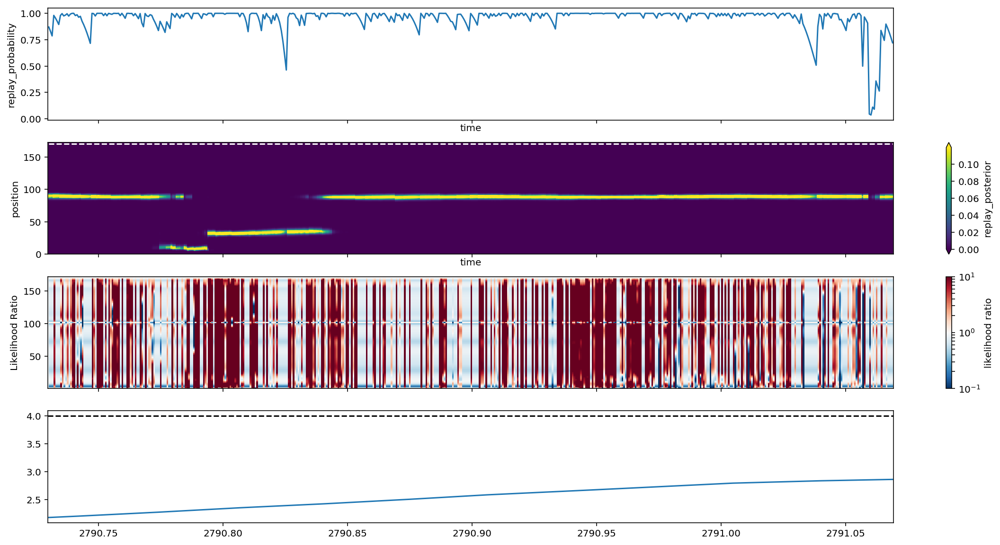

In [52]:
min_time, max_time = (2790.730 - 0.0), (2791.069 + 0.0)

ind = (results.time > min_time) & (results.time < max_time)

sm = plt.cm.ScalarMappable()
sm.set_array([])

fig, axes = plt.subplots(4, 1, figsize=(20, 10), sharex=True)

results.replay_probability.sel(time=slice(min_time, max_time)).plot(x='time', ax=axes[0])
plt.colorbar(sm, ax=axes[0]).ax.set_visible(False)
c = results.replay_posterior.sel(time=slice(min_time, max_time)).plot(x='time', y='position', robust=True, ax=axes[1])
axes[1].plot(results.time[ind], linear_distance[ind], linestyle='--', color='white');

likelihood = results.likelihood.sel(time=slice(min_time, max_time))
t, p = likelihood.time, likelihood.position
t, p = np.meshgrid(t, p)
cax = axes[2].pcolormesh(
    t, p, likelihood.values.T,
    norm=colors.LogNorm(1E-1, 1E1), cmap='RdBu_r')
axes[2].set_ylabel('Likelihood Ratio')
plt.colorbar(cax, ax=axes[2], label='likelihood ratio', orientation='vertical')

axes[3].plot(results.time[ind], speed.values[ind]);
axes[3].axhline(4, linestyle='--', color='black');
plt.colorbar(sm, ax=axes[3]).ax.set_visible(False)

In [14]:
is_multiunit_spike = np.all(~np.isnan(multiunit), axis=1).astype(np.float)

In [15]:
np.nonzero(spikes[ind])[0]

array([ 15,  20,  38,  40,  55,  56,  74,  89,  90,  96,  97, 101, 104,
       108, 110, 113, 123, 124, 147, 157, 168, 170, 182, 185, 196, 199,
       209, 227, 236, 284, 300, 306, 307, 307, 314, 315, 323, 330, 332,
       337, 339, 351, 359, 360, 374, 494])

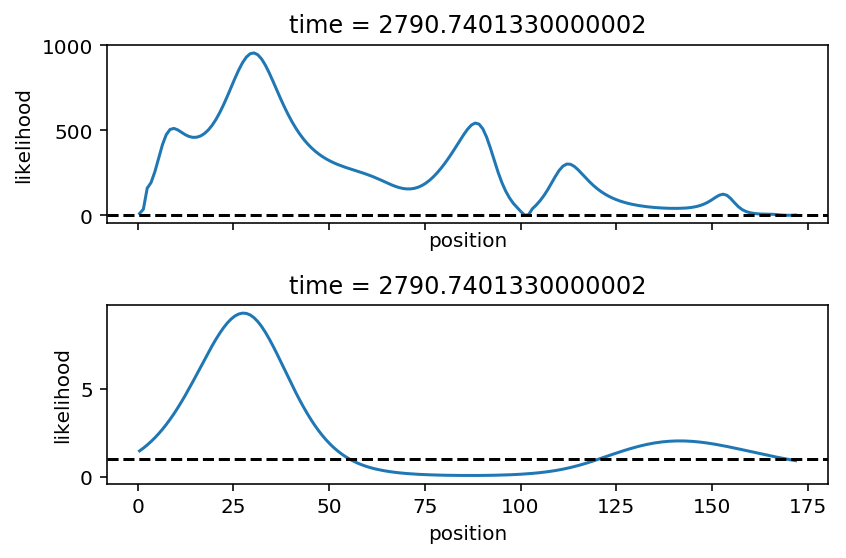

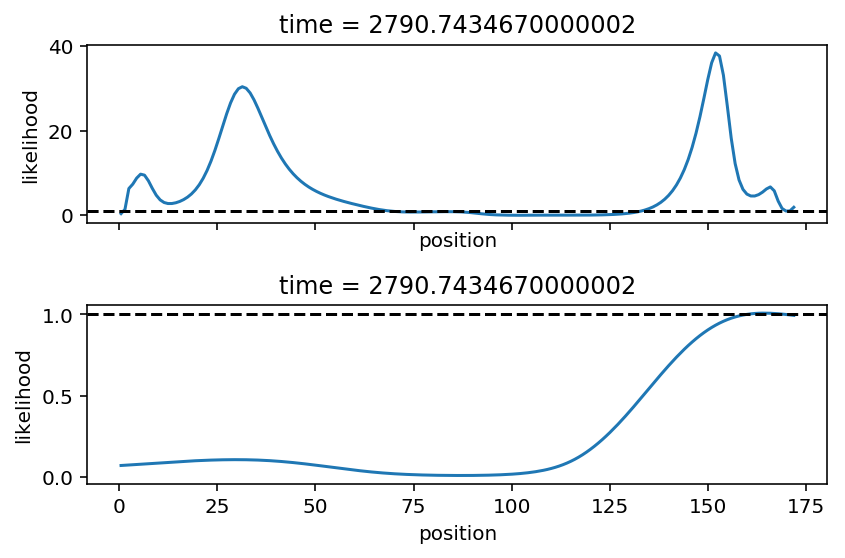

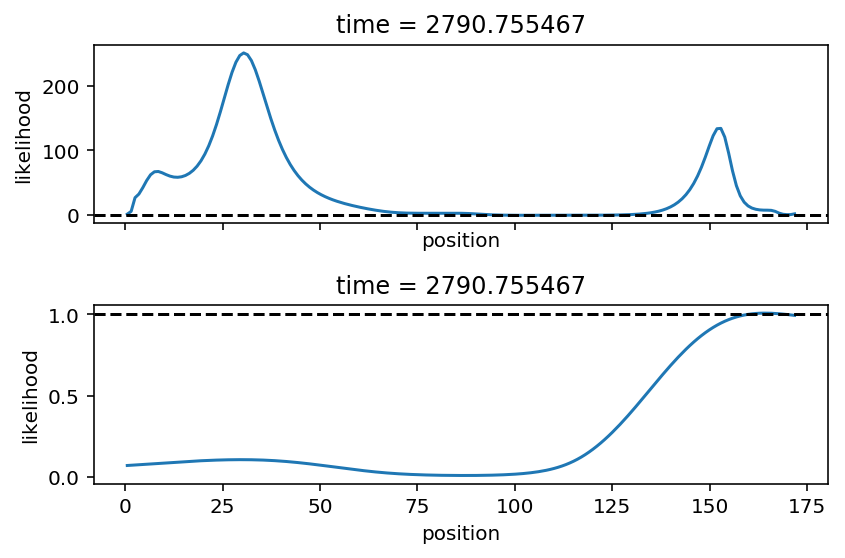

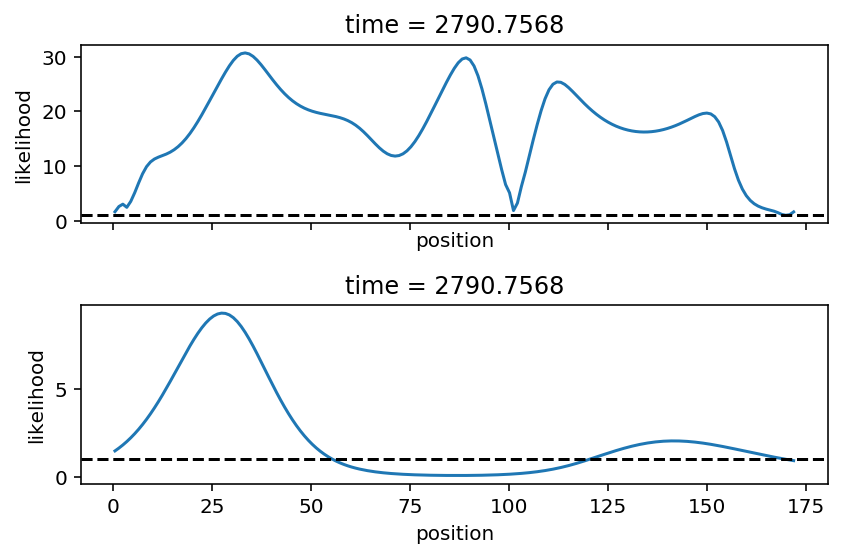

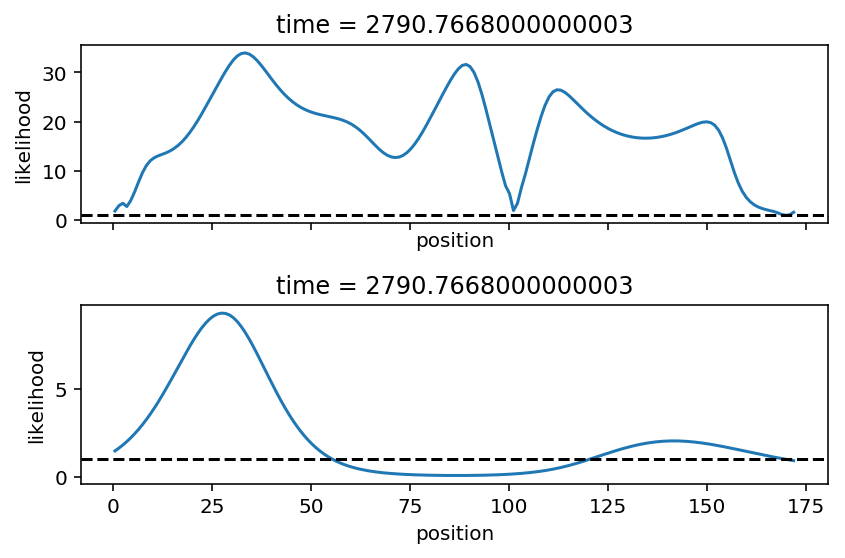

...

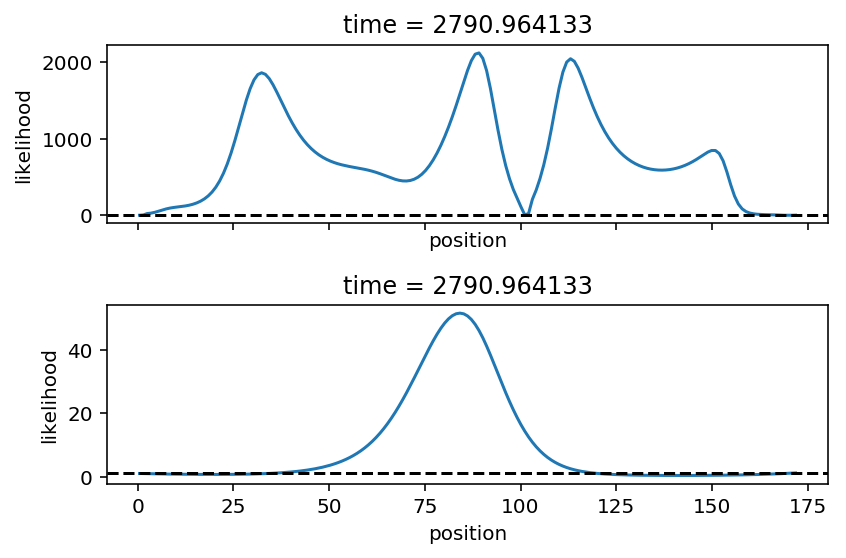

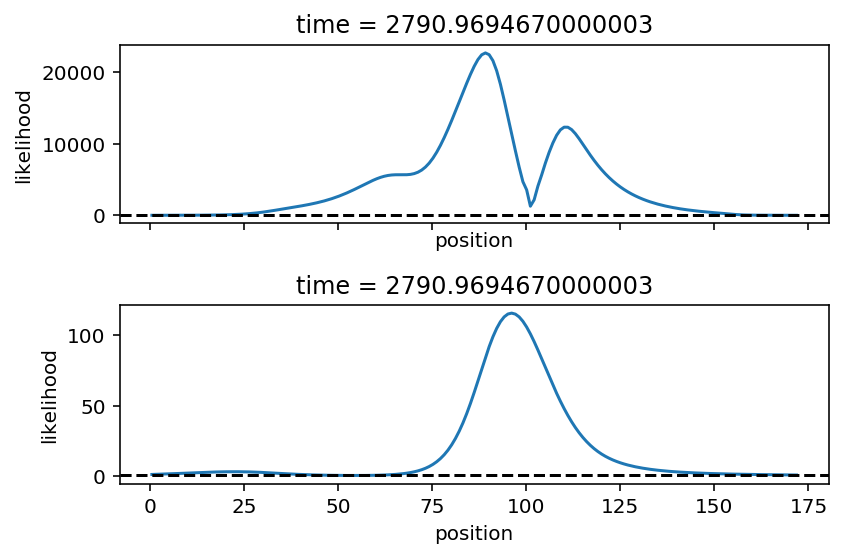

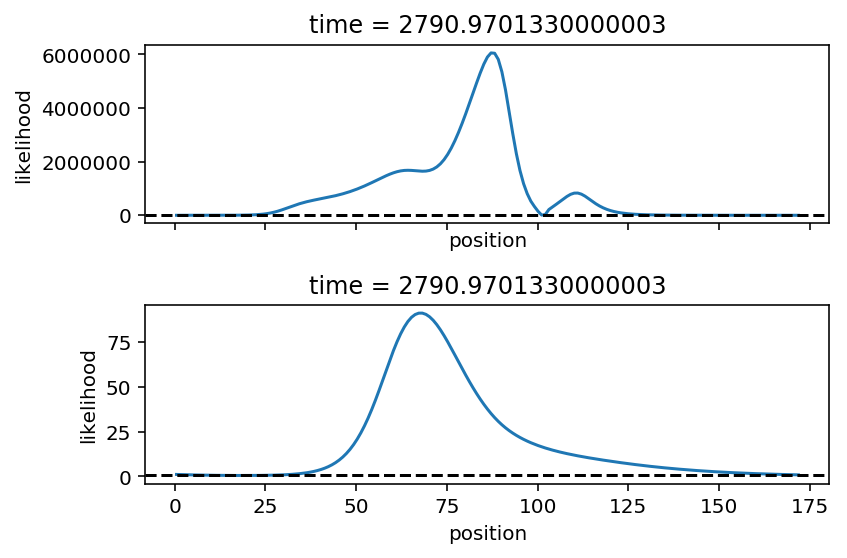

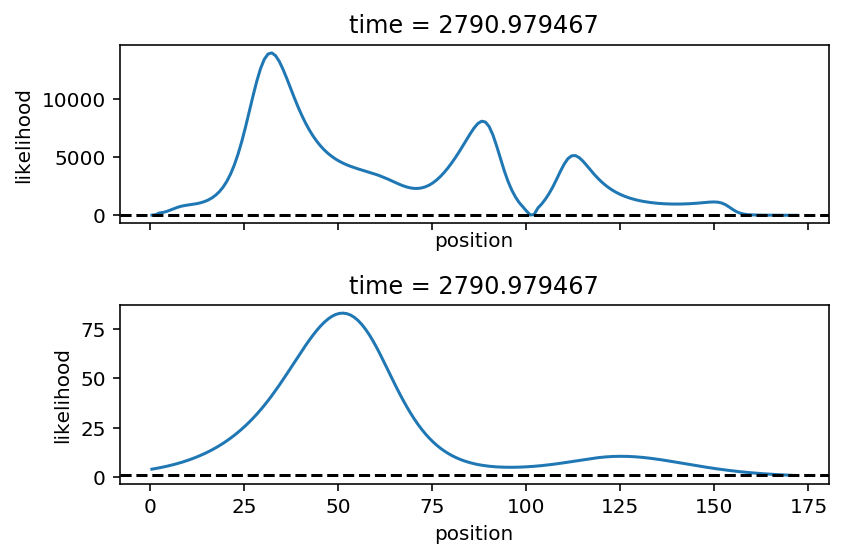

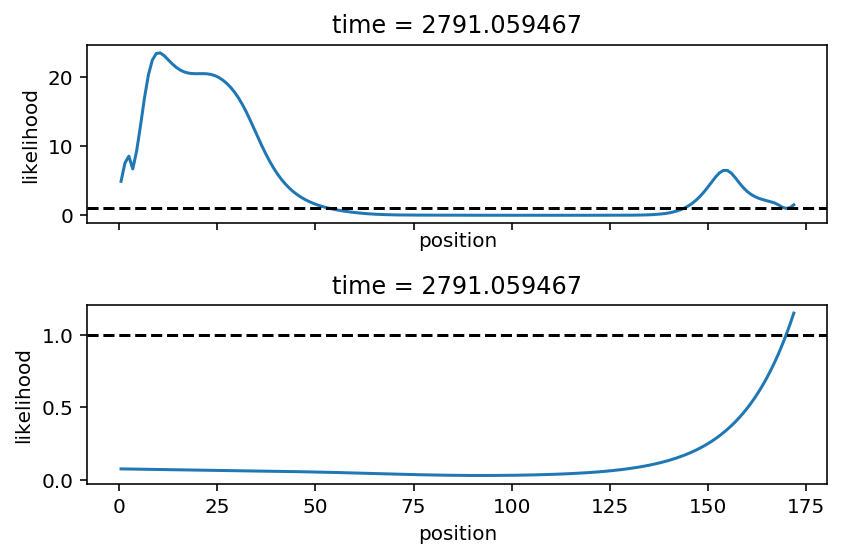

In [45]:
for spike_ind in np.nonzero(spikes[ind])[0]:
    fig, axes = plt.subplots(2, 1, sharex=True)
    results.likelihood[ind][spike_ind].plot(ax=axes[0])
    axes[0].axhline(1, color='black', linestyle='--')
    results_spikes.likelihood[ind][spike_ind].plot(ax=axes[1])
    axes[1].axhline(1, color='black', linestyle='--')
    plt.tight_layout()

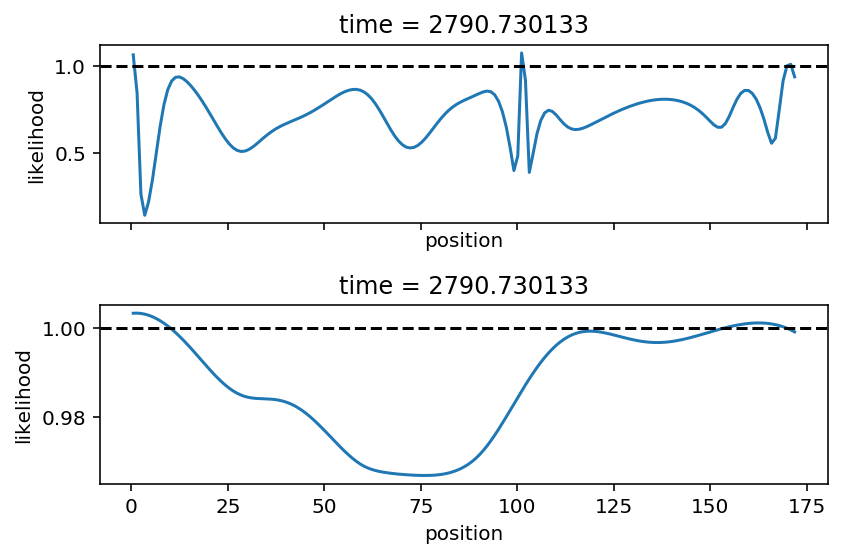

In [43]:
spike_ind = 0

fig, axes = plt.subplots(2, 1, sharex=True)
results.likelihood[ind][spike_ind].plot(ax=axes[0])
axes[0].axhline(1, color='black', linestyle='--')
results_spikes.likelihood[ind][spike_ind].plot(ax=axes[1])
axes[1].axhline(1, color='black', linestyle='--')
plt.tight_layout()

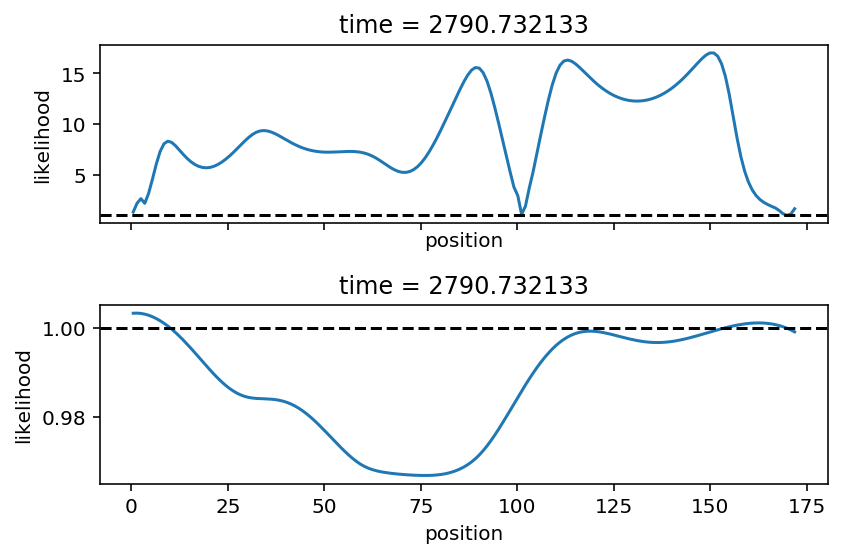

In [44]:
spike_ind = 3

fig, axes = plt.subplots(2, 1, sharex=True)
results.likelihood[ind][spike_ind].plot(ax=axes[0])
axes[0].axhline(1, color='black', linestyle='--')
results_spikes.likelihood[ind][spike_ind].plot(ax=axes[1])
axes[1].axhline(1, color='black', linestyle='--')
plt.tight_layout()

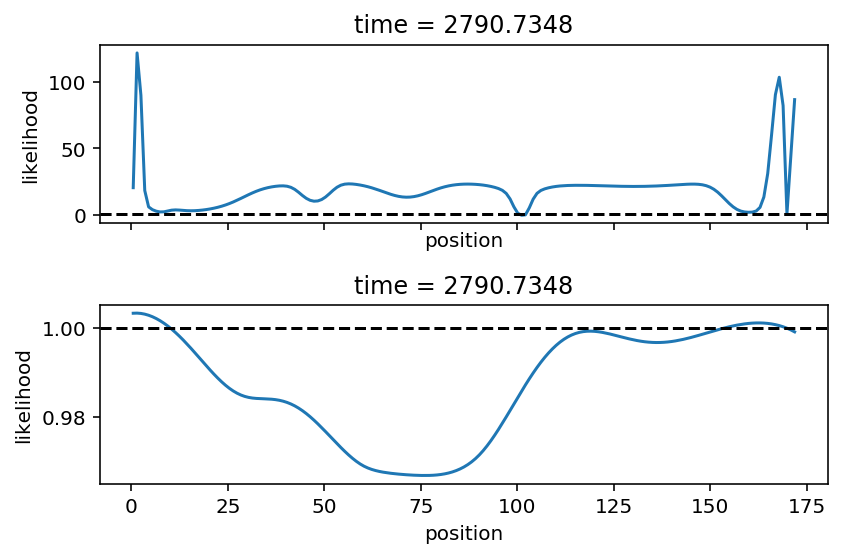

In [38]:
spike_ind = 7

fig, axes = plt.subplots(2, 1, sharex=True)
results.likelihood[ind][spike_ind].plot(ax=axes[0])
axes[0].axhline(1, color='black', linestyle='--')
results_spikes.likelihood[ind][spike_ind].plot(ax=axes[1])
axes[1].axhline(1, color='black', linestyle='--')
plt.tight_layout()

In [20]:
from replay_identification.multiunit_likelihood import combined_likelihood
position = linear_distance.copy()
joint_mark_intensity_functions = (
            detector._multiunit_likelihood_ratio.keywords[
                'joint_mark_intensity_functions'])
place_bin_centers = detector._multiunit_likelihood_ratio.keywords['place_bin_centers']
ground_process_intensity = detector._multiunit_likelihood_ratio.keywords['ground_process_intensity']
place_bins = detector._multiunit_likelihood_ratio.keywords['place_bins']
time_bin_size = 1

n_time = position.shape[0]

replay_log_likelihood = combined_likelihood(
    multiunit, place_bin_centers,
    joint_mark_intensity_functions, ground_process_intensity,
    time_bin_size)
bin_ind = np.digitize(position, place_bins)
is_nan = np.isnan(np.squeeze(position))
bin_ind[is_nan] = 0
no_replay_log_likelihood = replay_log_likelihood[
    (np.arange(n_time), bin_ind - 1)][:, np.newaxis]
no_replay_log_likelihood[is_nan] = np.nan

100%|██████████| 18/18 [14:27<00:00, 48.19s/it]


In [21]:
no_replay_log_likelihood[0]

array([-0.09512042])

In [22]:
replay_log_likelihood[0]

array([-0.09512042, -2.69574192, -3.07003758, -1.93291964, -1.18037351,
       -0.73974081, -0.50083017, -0.37679001, -0.31538927, -0.28949423,
       -0.28610865, -0.29945286, -0.3274316 , -0.36990145, -0.42762582,
       -0.50124046, -0.58979331, -0.68875786, -0.78825972, -0.8735108 ,
       -0.92939023, -0.94757416, -0.93050122, -0.8886924 , -0.83461717,
       -0.77817751, -0.72540137, -0.6791072 , -0.64006995, -0.60798279,
       -0.58207304, -0.56144353, -0.5452399 , -0.53271973, -0.52327039,
       -0.51640225, -0.51173172, -0.50896141, -0.50786117, -0.50825138,
       -0.50998896, -0.51295601, -0.51705067, -0.52217979, -0.52825289,
       -0.53517727, -0.54285384, -0.55117362, -0.56001484, -0.56924076,
       -0.57869834, -0.58821806, -0.59761505, -0.60669199, -0.6152439 ,
       -0.62306494, -0.629957  , -0.63573977, -0.64026137, -0.64340859,
       -0.64511556, -0.64536952, -0.64421301, -0.64174178, -0.63809867,
       -0.63346407, -0.62804418, -0.62205821, -0.61572614, -0.60

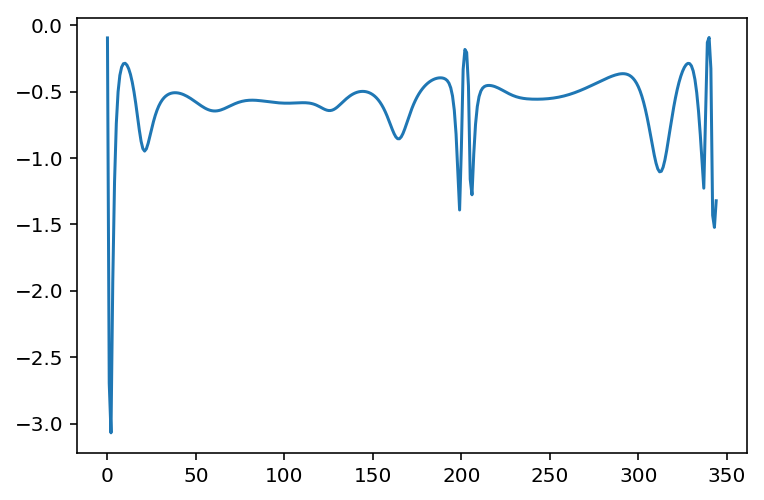

In [23]:
plt.plot(replay_log_likelihood[0])

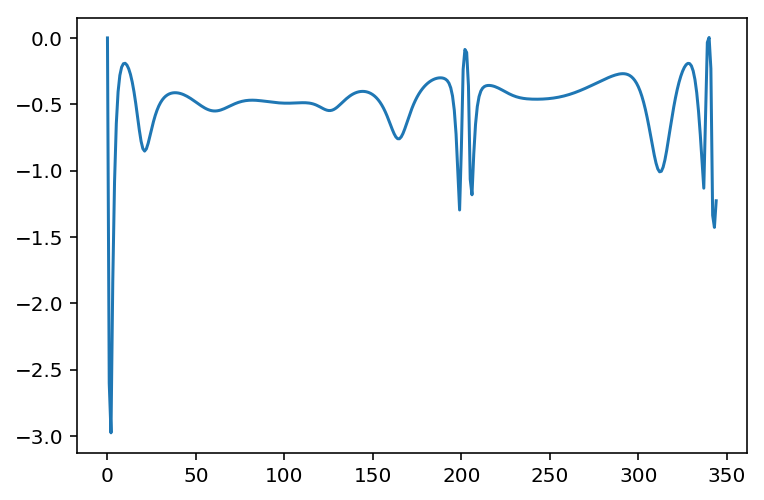

In [24]:
plt.plot(replay_log_likelihood[0] - no_replay_log_likelihood[0])

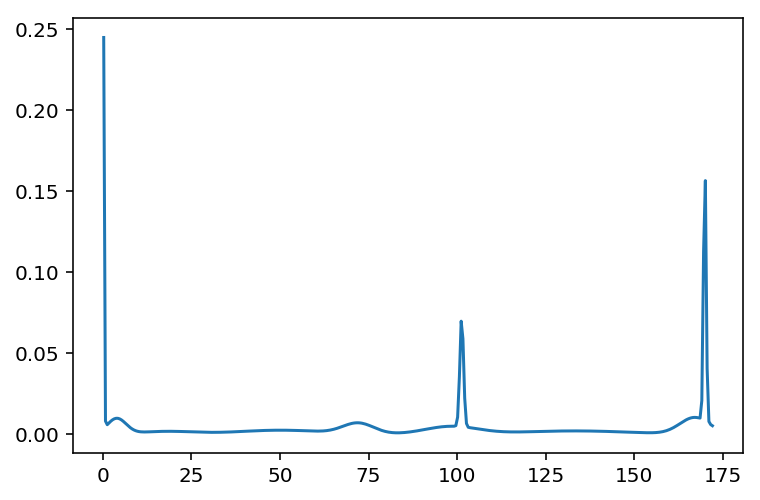

In [53]:
plt.plot(place_bin_centers, joint_mark_intensity_functions[0].keywords['place_occupancy'])

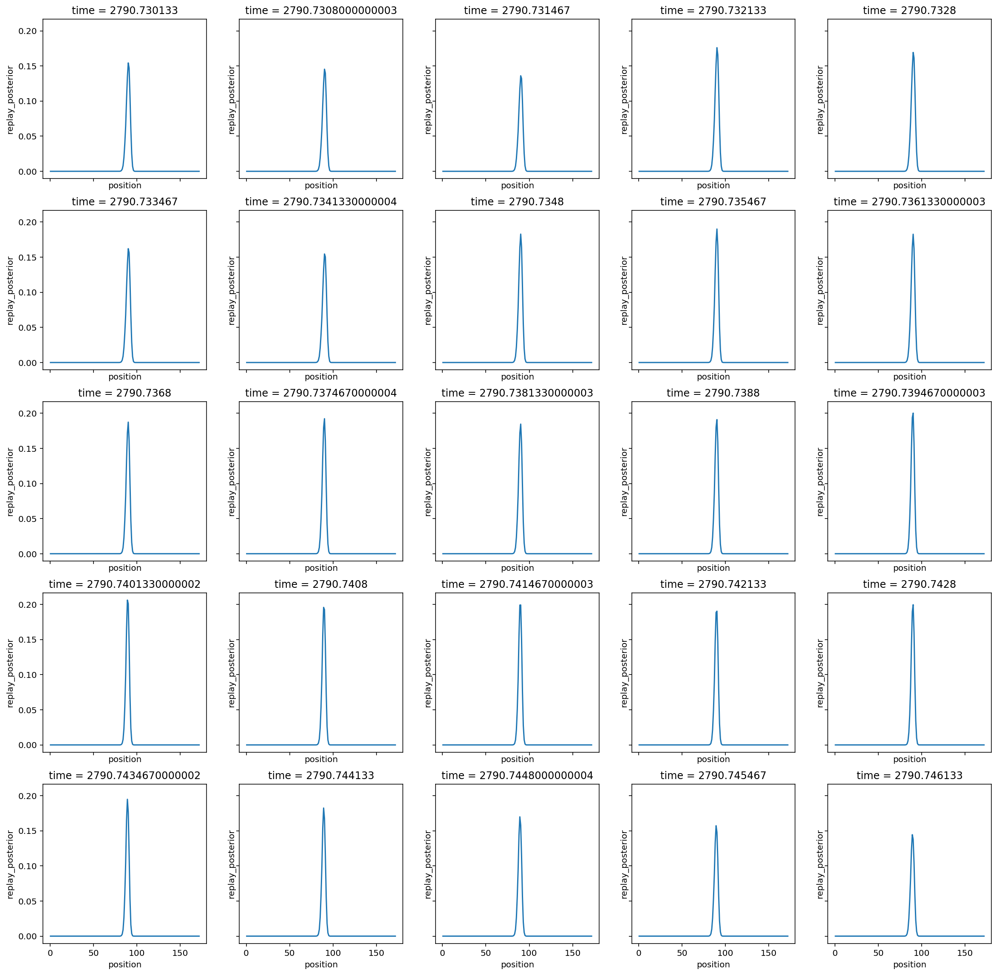

In [54]:
fig, axes = plt.subplots(5, 5, figsize=(20, 20), sharex=True, sharey=True)

for ax, i in zip(axes.ravel(), range(0, 25)):
    results.replay_posterior[ind][i].plot(ax=ax)

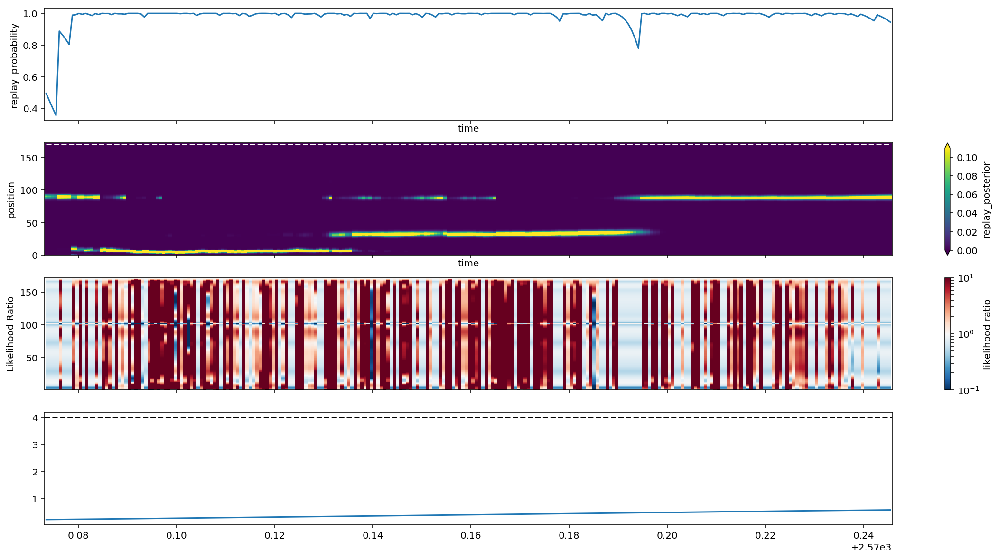

In [46]:
min_time, max_time = 2570.073, 2570.246

ind = (results.time > min_time) & (results.time < max_time)

sm = plt.cm.ScalarMappable()
sm.set_array([])

fig, axes = plt.subplots(4, 1, figsize=(20, 10), sharex=True)

results.replay_probability.sel(time=slice(min_time, max_time)).plot(x='time', ax=axes[0])
plt.colorbar(sm, ax=axes[0]).ax.set_visible(False)
c = results.replay_posterior.sel(time=slice(min_time, max_time)).plot(x='time', y='position', robust=True, ax=axes[1])
axes[1].plot(results.time[ind], linear_distance[ind], linestyle='--', color='white');

likelihood = results.likelihood.sel(time=slice(min_time, max_time))
t, p = likelihood.time, likelihood.position
t, p = np.meshgrid(t, p)
cax = axes[2].pcolormesh(
    t, p, likelihood.values.T,
    norm=colors.LogNorm(1E-1, 1E1), cmap='RdBu_r')
axes[2].set_ylabel('Likelihood Ratio')
plt.colorbar(cax, ax=axes[2], label='likelihood ratio', orientation='vertical')

axes[3].plot(results.time[ind], speed.values[ind]);
axes[3].axhline(4, linestyle='--', color='black');
plt.colorbar(sm, ax=axes[3]).ax.set_visible(False)

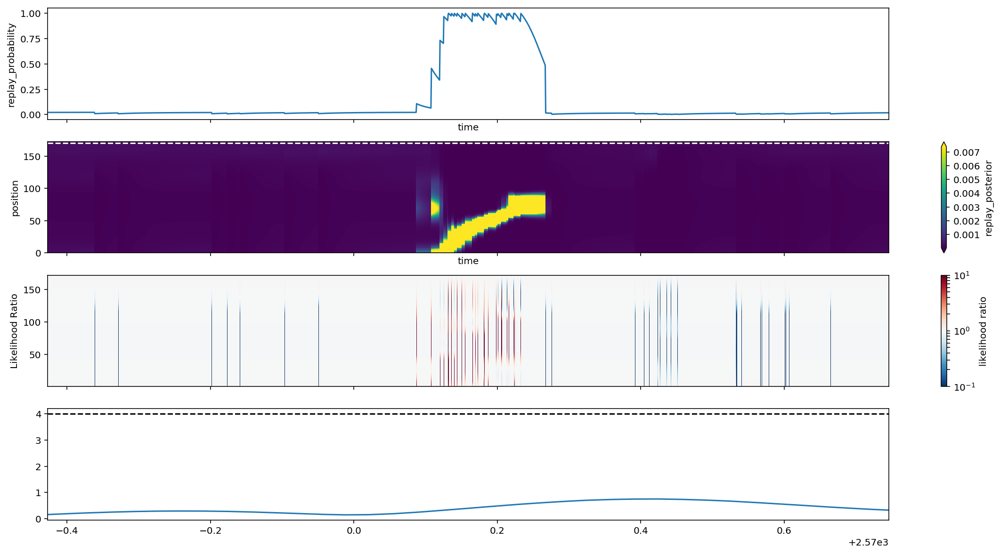

In [48]:
min_time, max_time = 2570.073 - 0.5, 2570.246 + 0.5

ind = (results_spikes.time > min_time) & (results_spikes.time < max_time)

sm = plt.cm.ScalarMappable()
sm.set_array([])

fig, axes = plt.subplots(4, 1, figsize=(20, 10), sharex=True)

results_spikes.replay_probability.sel(time=slice(min_time, max_time)).plot(x='time', ax=axes[0])
plt.colorbar(sm, ax=axes[0]).ax.set_visible(False)
c = results_spikes.replay_posterior.sel(time=slice(min_time, max_time)).plot(x='time', y='position', robust=True, ax=axes[1])
axes[1].plot(results_spikes.time[ind], linear_distance[ind], linestyle='--', color='white');

likelihood = results_spikes.likelihood.sel(time=slice(min_time, max_time))
t, p = likelihood.time, likelihood.position
t, p = np.meshgrid(t, p)
cax = axes[2].pcolormesh(
    t, p, likelihood.values.T,
    norm=colors.LogNorm(1E-1, 1E1), cmap='RdBu_r')
axes[2].set_ylabel('Likelihood Ratio')
plt.colorbar(cax, ax=axes[2], label='likelihood ratio', orientation='vertical')

axes[3].plot(results_spikes.time[ind], speed.values[ind]);
axes[3].axhline(4, linestyle='--', color='black');
plt.colorbar(sm, ax=axes[3]).ax.set_visible(False)

INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:48<00:00,  2.70s/it]
INFO:replay_identification.decoders:Predicting replay probability and density...


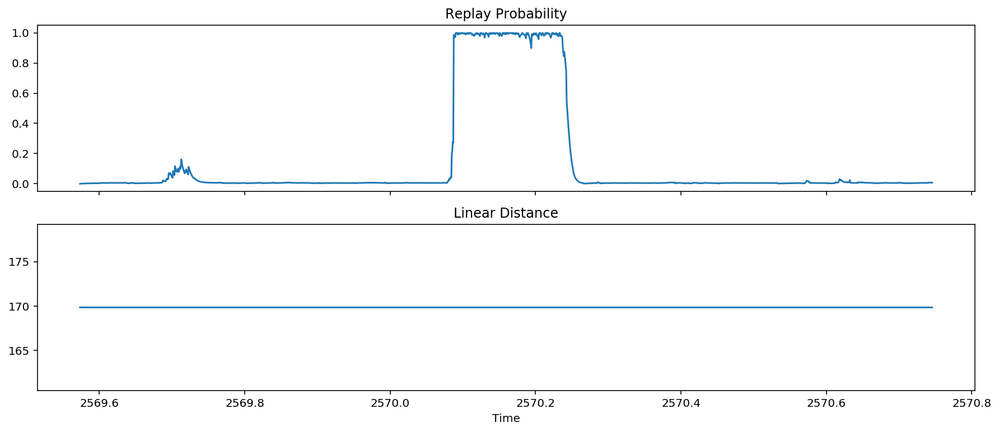

In [49]:
min_time, max_time = 2570.073 - 0.5, 2570.246 + 0.5

ind = (time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)

results = detector.predict(
    speed.values[ind], linear_distance[ind], multiunit=multiunit[ind], time=time.total_seconds().values[ind],
    use_likelihoods=['multiunit'])

fig, axes = plt.subplots(2, 1, sharex=True, figsize=(15, 6))
axes[0].plot(results.time, results.replay_probability)
axes[0].set_title('Replay Probability')
axes[1].plot(results.time, linear_distance[ind])
axes[1].set_title('Linear Distance')
axes[-1].set_xlabel('Time');

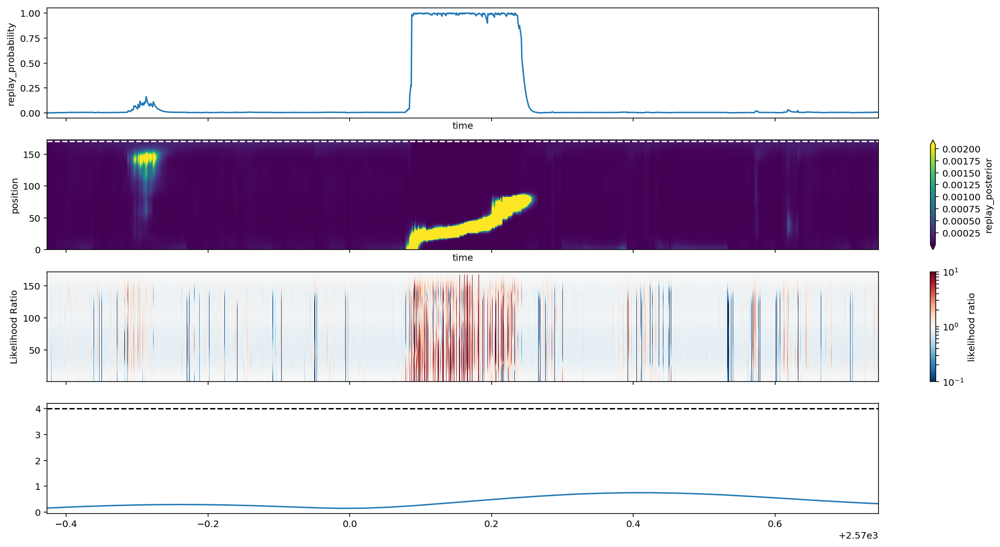

In [50]:
ind = (results.time > min_time) & (results.time < max_time)

sm = plt.cm.ScalarMappable()
sm.set_array([])

fig, axes = plt.subplots(4, 1, figsize=(20, 10), sharex=True)

results.replay_probability.sel(time=slice(min_time, max_time)).plot(x='time', ax=axes[0])
plt.colorbar(sm, ax=axes[0]).ax.set_visible(False)
c = results.replay_posterior.sel(time=slice(min_time, max_time)).plot(x='time', y='position', robust=True, ax=axes[1])
axes[1].plot(results.time[ind], linear_distance[(time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)], linestyle='--', color='white');

likelihood = results.likelihood.sel(time=slice(min_time, max_time))
t, p = likelihood.time, likelihood.position
t, p = np.meshgrid(t, p)
cax = axes[2].pcolormesh(
    t, p, likelihood.values.T,
    norm=colors.LogNorm(1E-1, 1E1), cmap='RdBu_r')
axes[2].set_ylabel('Likelihood Ratio')
plt.colorbar(cax, ax=axes[2], label='likelihood ratio', orientation='vertical')

axes[3].plot(results.time[ind], speed.values[(time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)]);
axes[3].axhline(4, linestyle='--', color='black');
plt.colorbar(sm, ax=axes[3]).ax.set_visible(False)

In [24]:
ind = (time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)
results_spikes = detector.predict(
    speed.values[ind], linear_distance[ind], spikes=spikes[ind], time=time.total_seconds().values[ind],
    use_likelihoods=['spikes'])

INFO:replay_identification.decoders:Predicting spikes likelihood...
100%|██████████| 31/31 [00:00<00:00, 63.73it/s]
INFO:replay_identification.decoders:Predicting replay probability and density...


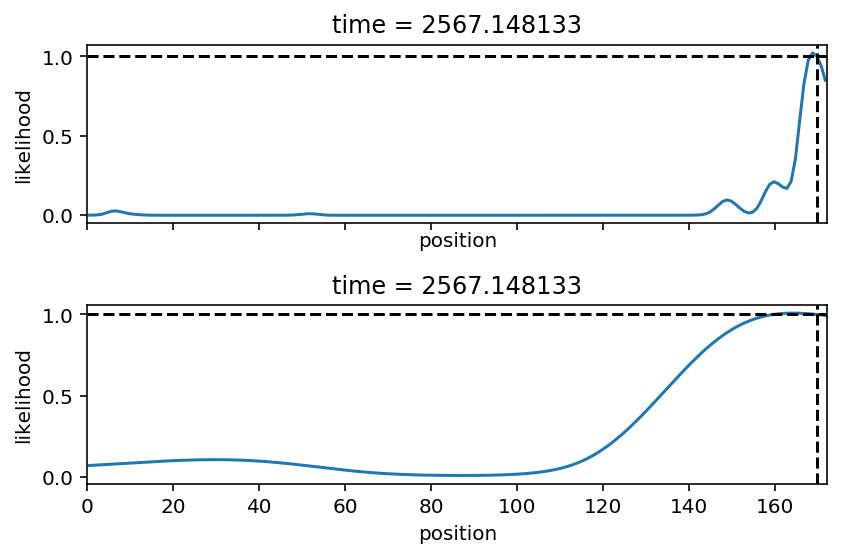

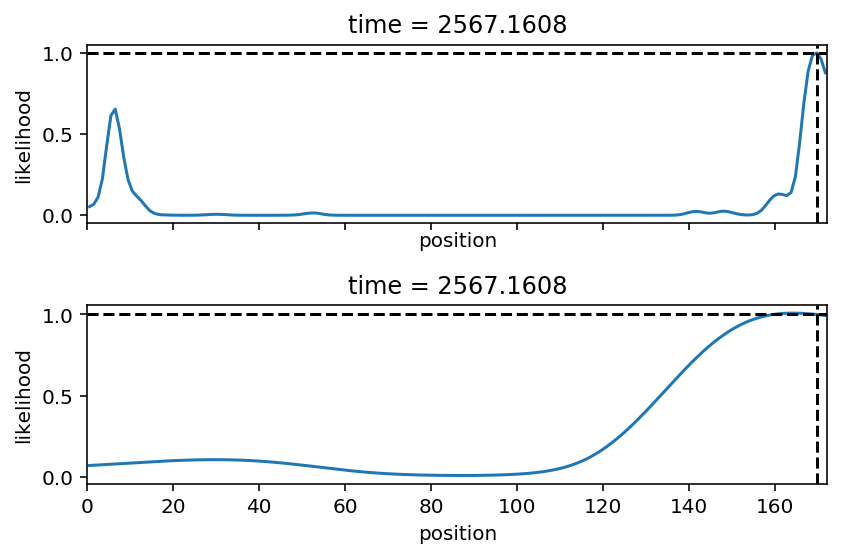

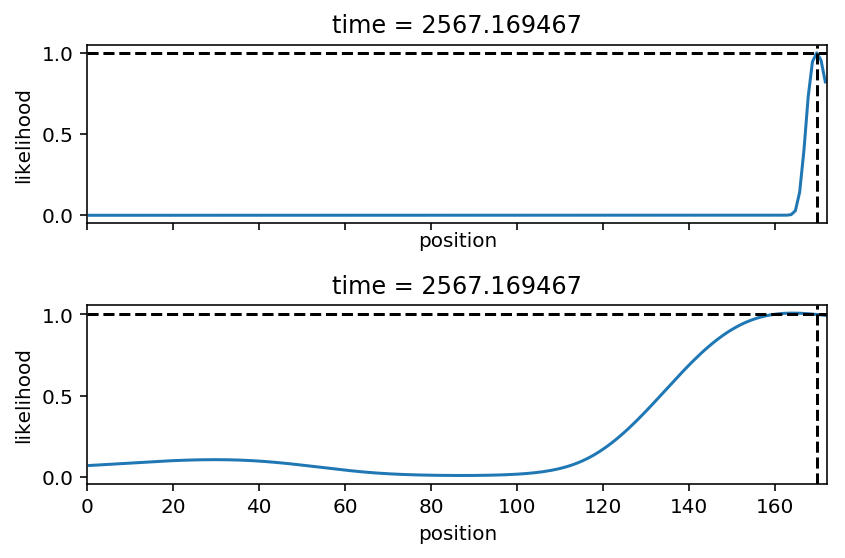

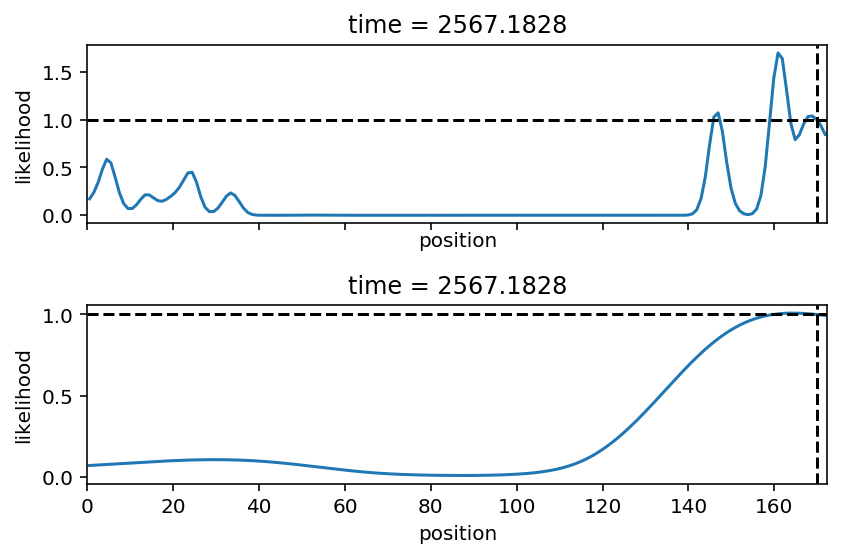

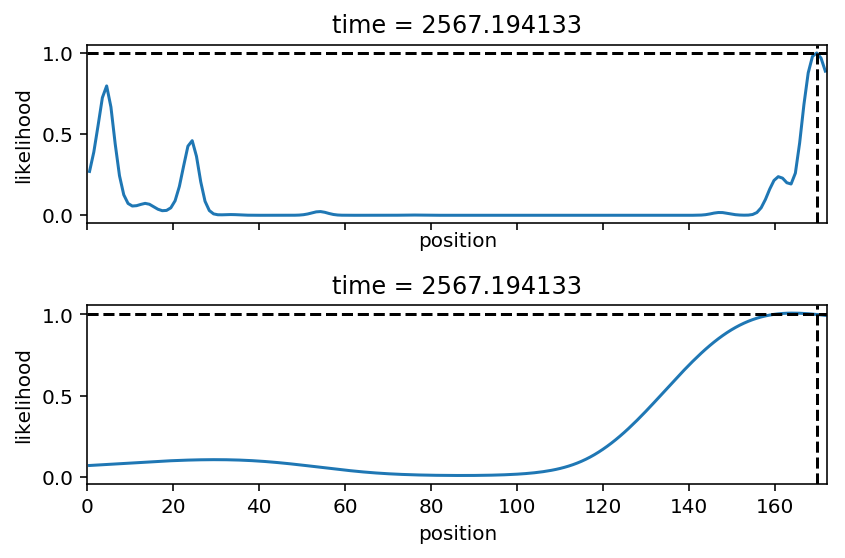

...

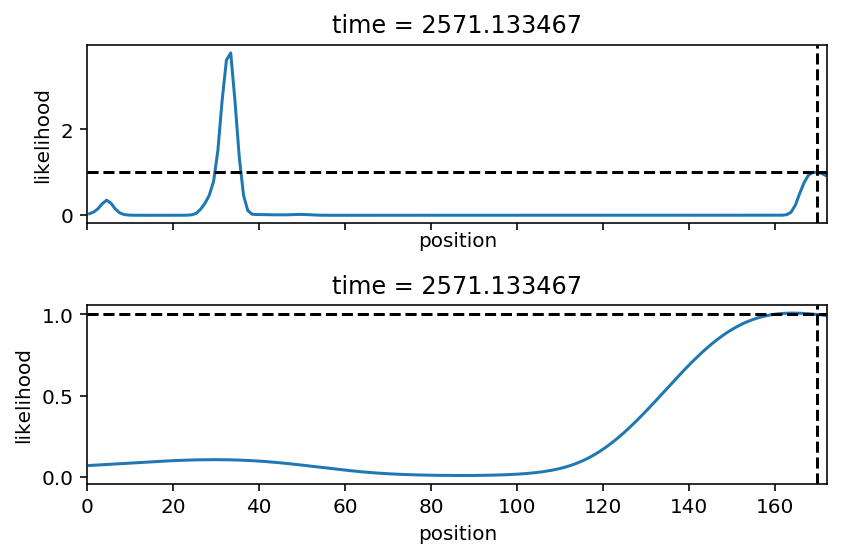

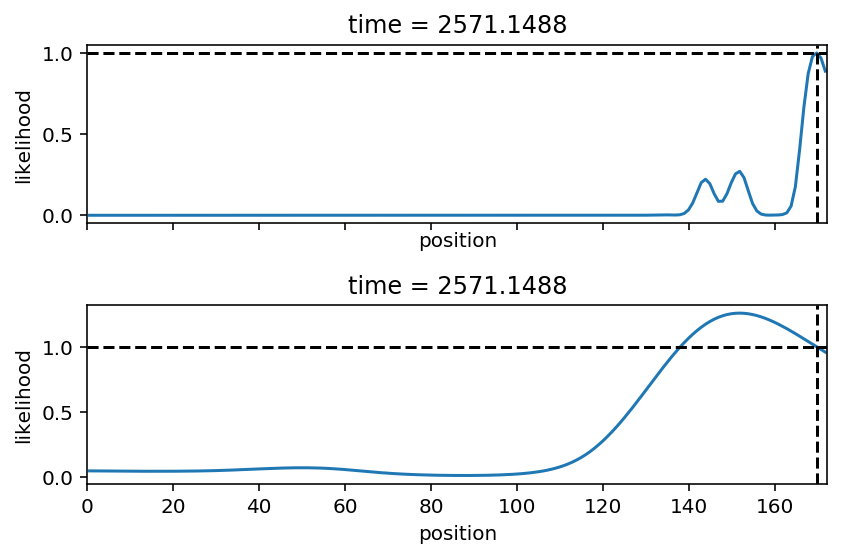

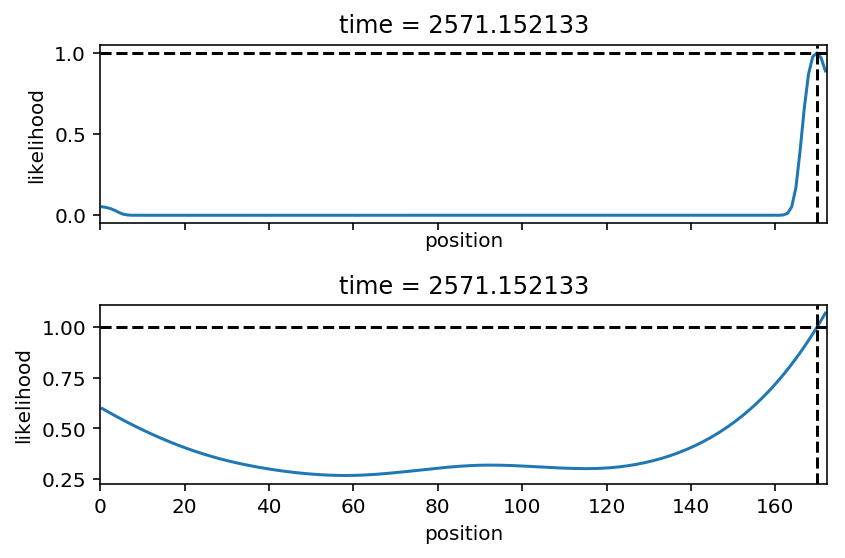

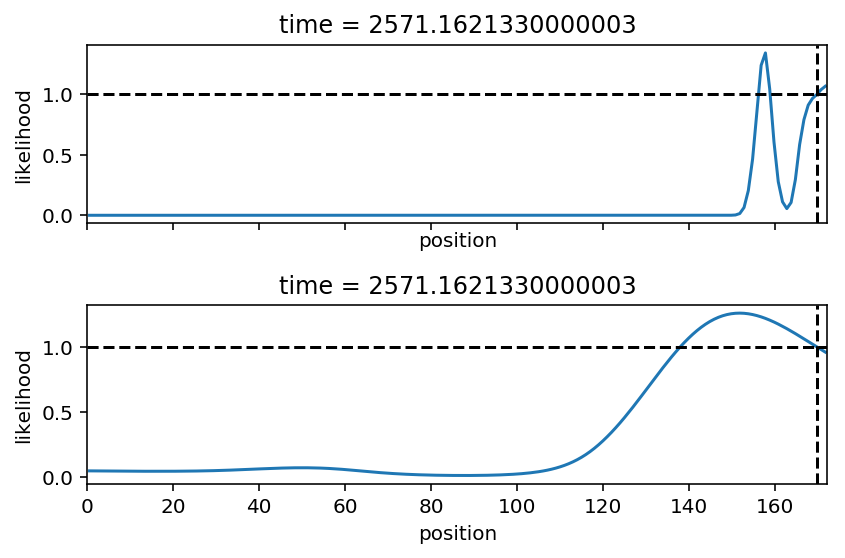

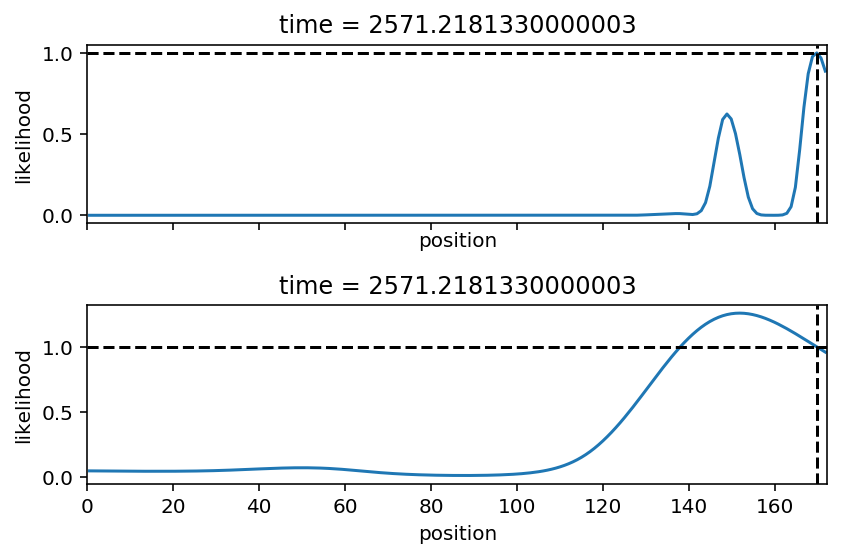

In [41]:
i = (time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)
ind = (results.time > min_time) & (results.time < max_time)

for spike_ind in np.nonzero(spikes[i])[0]:
    fig, axes = plt.subplots(2, 1, sharex=True)
    results.likelihood[spike_ind].plot(ax=axes[0])
    axes[0].axhline(1, color='black', linestyle='--')
    results_spikes.likelihood[spike_ind].plot(ax=axes[1])
    axes[1].axhline(1, color='black', linestyle='--')
    axes[0].axvline(linear_distance[i][spike_ind], color='black', linestyle='--')
    axes[1].axvline(linear_distance[i][spike_ind], color='black', linestyle='--')
    plt.xlim((0, np.nanmax(linear_distance)))
    plt.tight_layout()

In [62]:
tetrode_ind = 8
jmi = detector._multiunit_likelihood_ratio.keywords['joint_mark_intensity_functions']
place_bins = detector.place_bin_centers
plt.plot(place_bins, jmi[tetrode_ind](multiunit[i][spike_ind][:,tetrode_ind], place_bins).T)

KeyError: 'joint_mark_intensity_functions'

In [28]:
from ipywidgets import interact

tetrode_ind = 0
jmi = detector._multiunit_likelihood_ratio.keywords['joint_mark_intensity_functions']
spike_ind = np.nonzero(np.all(~np.isnan(multiunit[:, :, tetrode_ind]), axis=1))[0]
place_bins = detector.place_bin_centers


def joint(time_ind):
    blah = []

    for bin in place_bins:
        predict_data = np.concatenate((multiunit[spike_ind[time_ind], :, tetrode_ind][:, np.newaxis], np.array(bin)[np.newaxis, np.newaxis]))
        blah.append(jmi[tetrode_ind].keywords['fitted_model'].score_samples(predict_data.T))
    
    plt.figure(figsize=(6, 4))
    plt.plot(place_bins, np.exp(blah))
    plt.gca().axvline(linear_distance[spike_ind[time_ind]], color='black', linestyle='--')
    plt.title(multiunit[spike_ind[time_ind], :, tetrode_ind])
    plt.tight_layout()
    
n_spikes = len(spike_ind)
interact(joint, time_ind=(1, n_spikes));

interactive(children=(IntSlider(value=9734, description='time_ind', max=19468, min=1), Output()), _dom_classes=('widget-interact',))

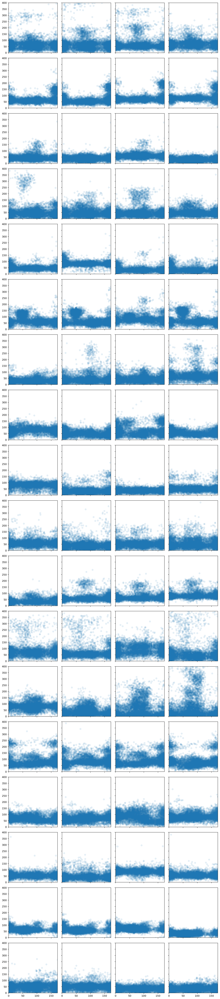

In [30]:
detector.plot_fitted_multiunit_model();

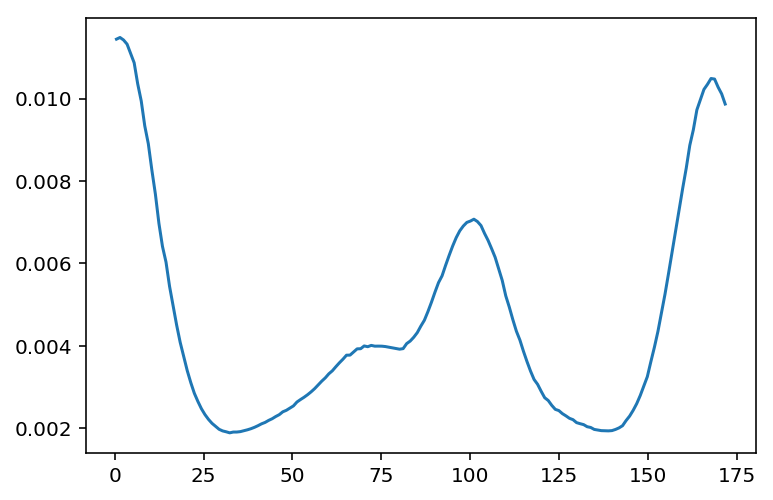

In [19]:
plt.plot(detector.place_bin_centers, detector._multiunit_likelihood_ratio.keywords[
                'joint_mark_intensity_functions'][3].keywords['place_occupancy'])


In [77]:
from ipywidgets import interact

tetrode_ind = 2
jmi = detector._multiunit_likelihood_ratio.keywords['joint_mark_intensity_functions']
spike_ind = np.nonzero(np.all(~np.isnan(multiunit[:, :, tetrode_ind]), axis=1))[0]
place_bins = detector.place_bin_centers
place_occupancy = detector._multiunit_likelihood_ratio.keywords[
                'joint_mark_intensity_functions'][3].keywords['place_occupancy']


def joint2(time_ind):
    blah = []

    for bin in place_bins:
        predict_data = np.concatenate((multiunit[spike_ind[time_ind], :, tetrode_ind][:, np.newaxis], np.array(bin)[np.newaxis, np.newaxis]))
        blah.append(jmi[tetrode_ind].keywords['fitted_model'].score_samples(predict_data.T))
    blah = np.array(blah)
    fig, axes = plt.subplots(3, 1, figsize=(10, 5), sharex=True)
    axes[0].plot(place_bins, np.exp(blah.squeeze()))
    axes[0].axvline(linear_distance[spike_ind[time_ind]], color='black', linestyle='--')
    axes[0].set_title('Joint Density' + str(multiunit[spike_ind[time_ind], :, tetrode_ind]))

    axes[1].plot(place_bins, place_occupancy)
    axes[1].axvline(linear_distance[spike_ind[time_ind]], color='black', linestyle='--')
    axes[1].set_title('Occupancy')
    
    axes[2].plot(place_bins, jmi[tetrode_ind](multiunit[spike_ind[time_ind], :, tetrode_ind], place_bins).squeeze())
    axes[2].axvline(linear_distance[spike_ind[time_ind]], color='black', linestyle='--')
    axes[2].set_title('Joint Intensity')
    axes[2].set_xlabel('Position')


    plt.tight_layout()
    
n_spikes = len(spike_ind)
interact(joint2, time_ind=(1, n_spikes));

interactive(children=(IntSlider(value=16837, description='time_ind', max=33673, min=1), Output()), _dom_classes=('widget-interact',))

INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:04<00:00,  3.81it/s]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:00<00:00, 1292.46it/s]
INFO:replay_identification.decoders:Predicting replay probability and density...
INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:08<00:00,  2.06it/s]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:00<00:00, 1447.06it/s]
INFO:replay_identificatio

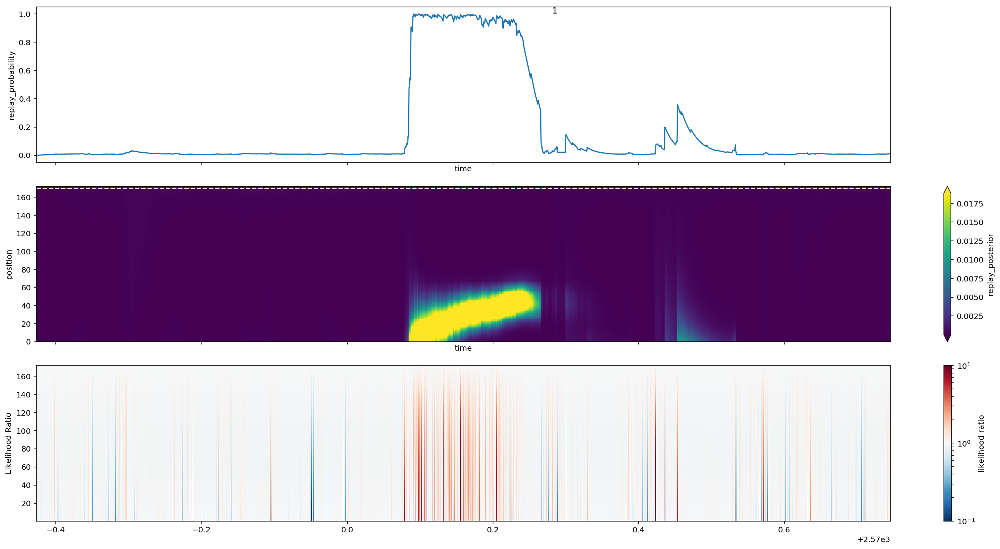

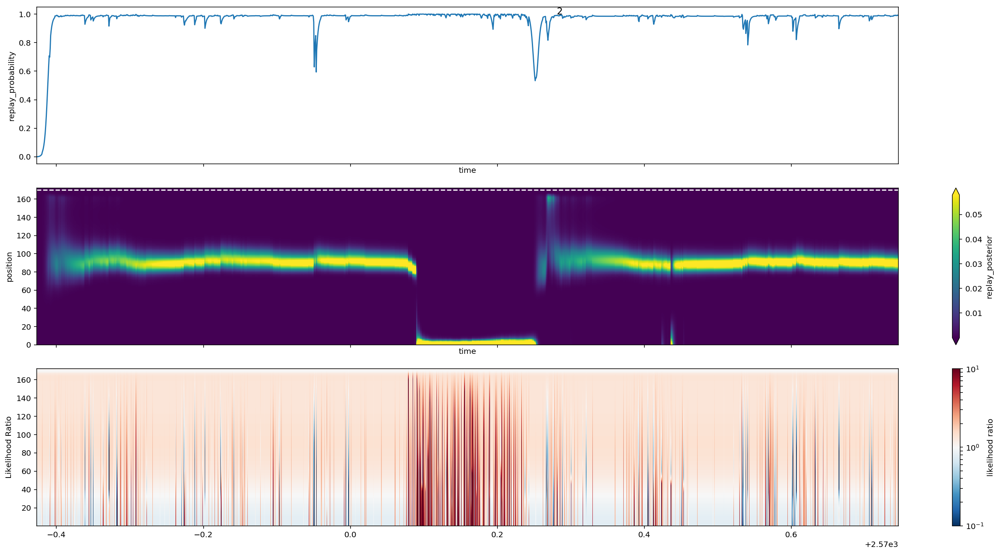

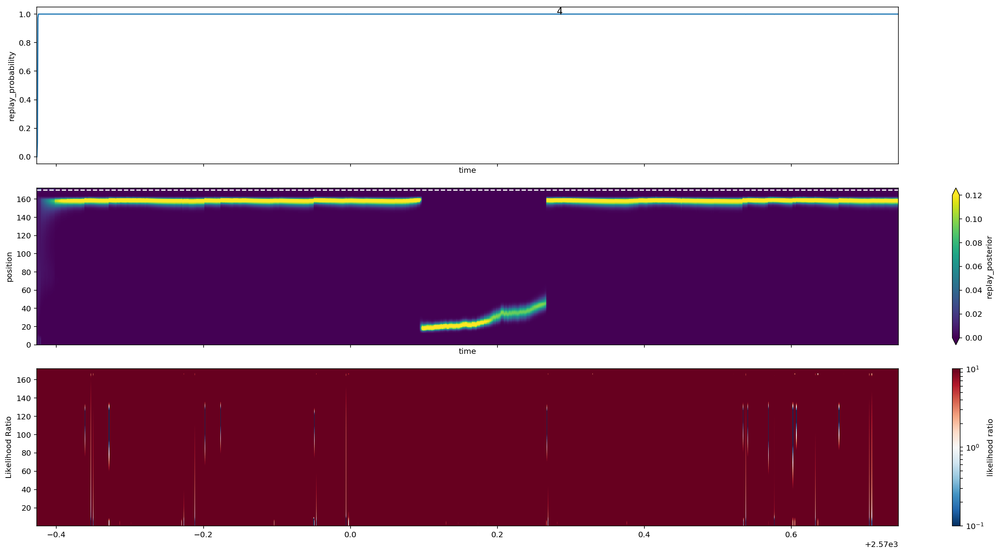

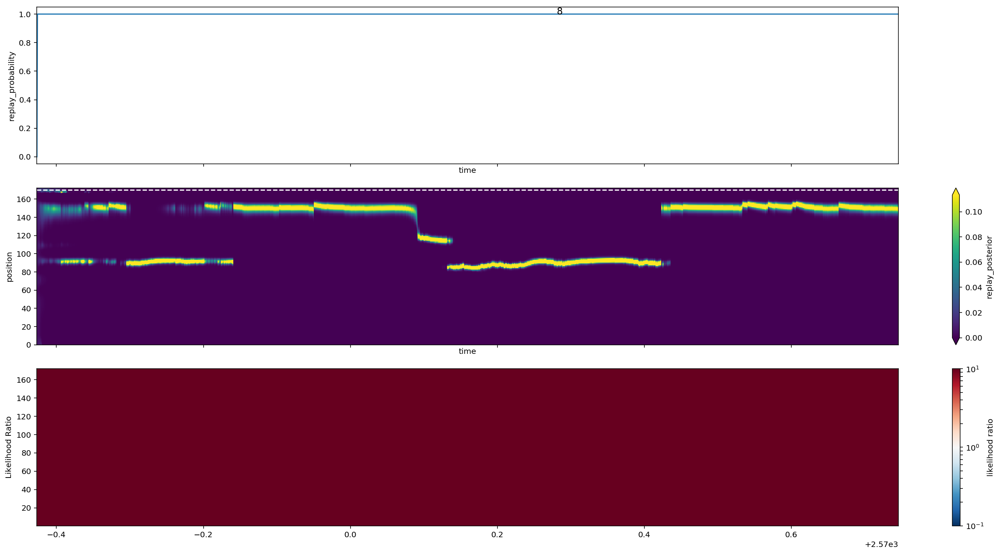

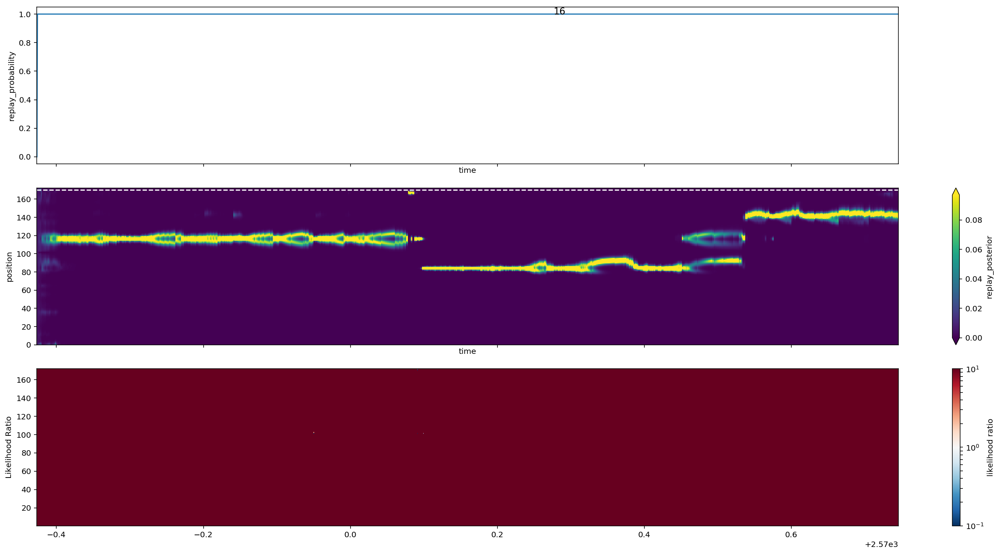

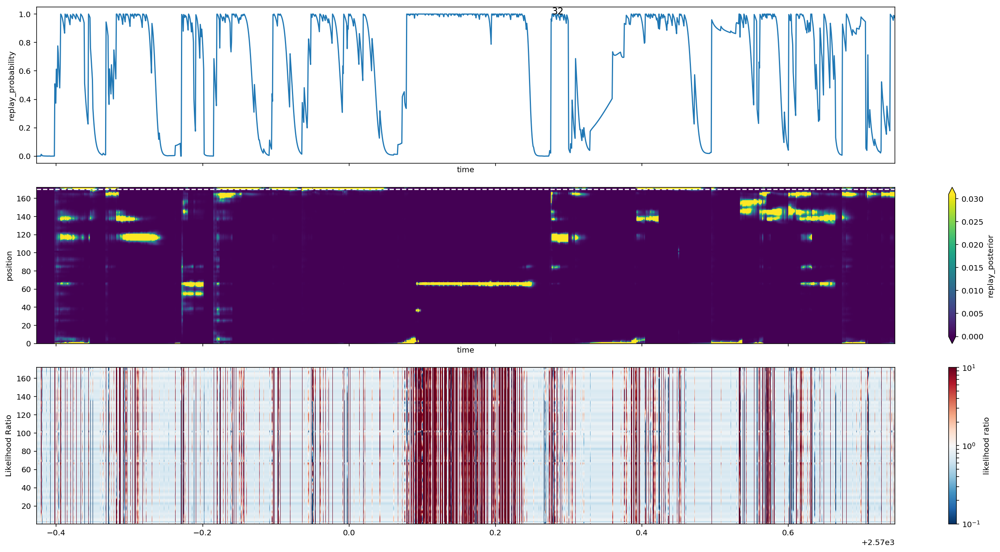

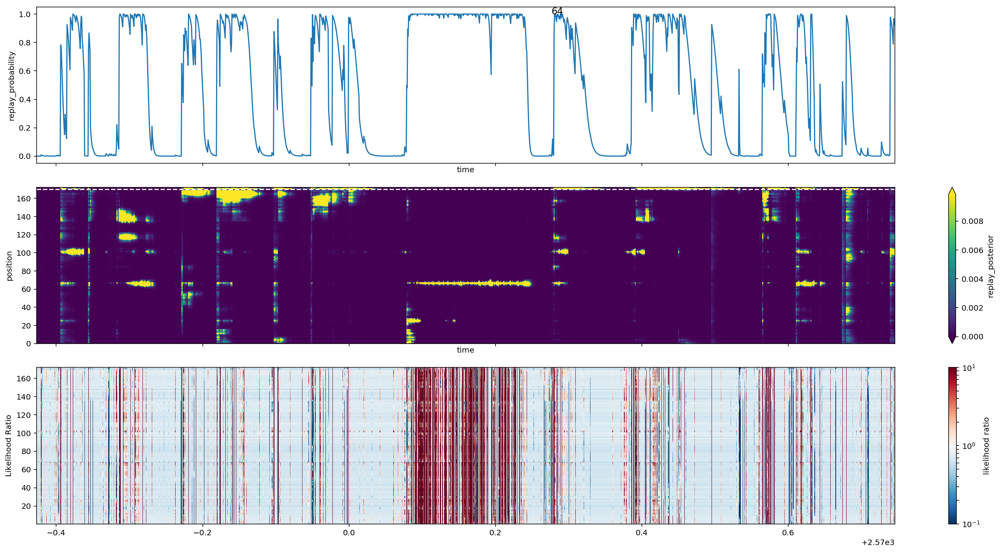

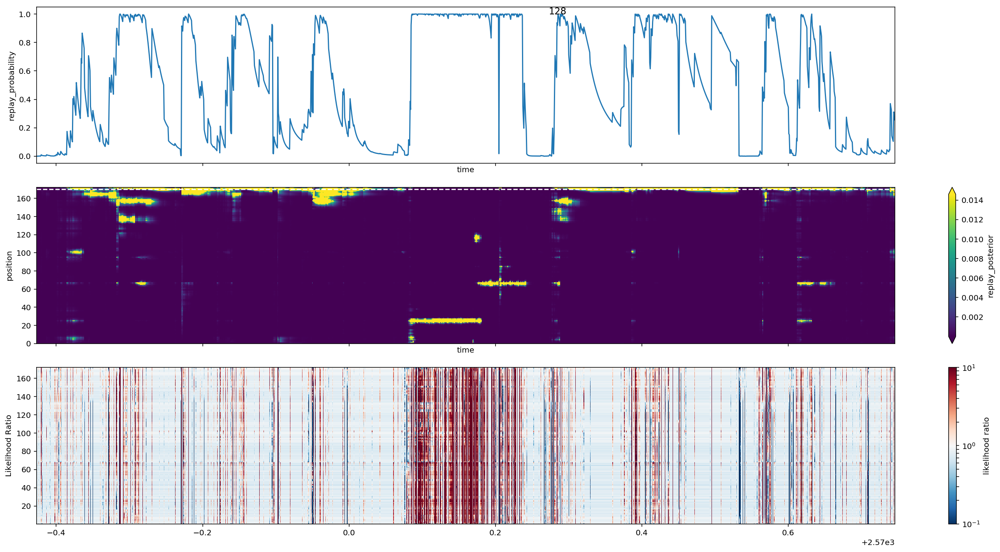

In [61]:
from sklearn.mixture import GaussianMixture

COMPONENTS = [1, 2, 4, 8, 16, 32, 64, 128]
min_time, max_time = 2570.073 - 0.5, 2570.246 + 0.5
sm = plt.cm.ScalarMappable()
sm.set_array([])

for n_components in COMPONENTS:
    ind = (time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)
    detector = ReplayDetector(
        replay_speed=16,
        multiunit_density_model=GaussianMixture,
        multiunit_model_kwargs=dict(n_components=n_components))
    detector.fit(
        is_ripple, speed.values, linear_distance, multiunit=multiunit)
    results = detector.predict(
        speed.values[ind], linear_distance[ind], multiunit=multiunit[ind], time=time.total_seconds().values[ind],
        use_likelihoods=['multiunit'])
    ind = (results.time > min_time) & (results.time < max_time)

    fig, axes = plt.subplots(3, 1, figsize=(20, 10), sharex=True)

    results.replay_probability.sel(time=slice(min_time, max_time)).plot(x='time', ax=axes[0])
    plt.colorbar(sm, ax=axes[0]).ax.set_visible(False)
    c = results.replay_posterior.sel(time=slice(min_time, max_time)).plot(x='time', y='position', robust=True, ax=axes[1])
    axes[1].plot(results.time[ind], linear_distance[(time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)], linestyle='--', color='white');

    likelihood = results.likelihood.sel(time=slice(min_time, max_time))
    t, p = likelihood.time, likelihood.position
    t, p = np.meshgrid(t, p)
    cax = axes[2].pcolormesh(
        t, p, likelihood.values.T,
        norm=colors.LogNorm(1E-1, 1E1), cmap='RdBu_r')
    axes[2].set_ylabel('Likelihood Ratio')
    plt.colorbar(cax, ax=axes[2], label='likelihood ratio', orientation='vertical')
    plt.suptitle(n_components)
    plt.tight_layout()
    

INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:07<00:00,  2.29it/s]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:55<00:00,  3.07s/it]
INFO:replay_identification.decoders:Predicting replay probability and density...
INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:04<00:00,  3.68it/s]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:52<00:00,  2.90s/it]
INFO:replay_identification.de

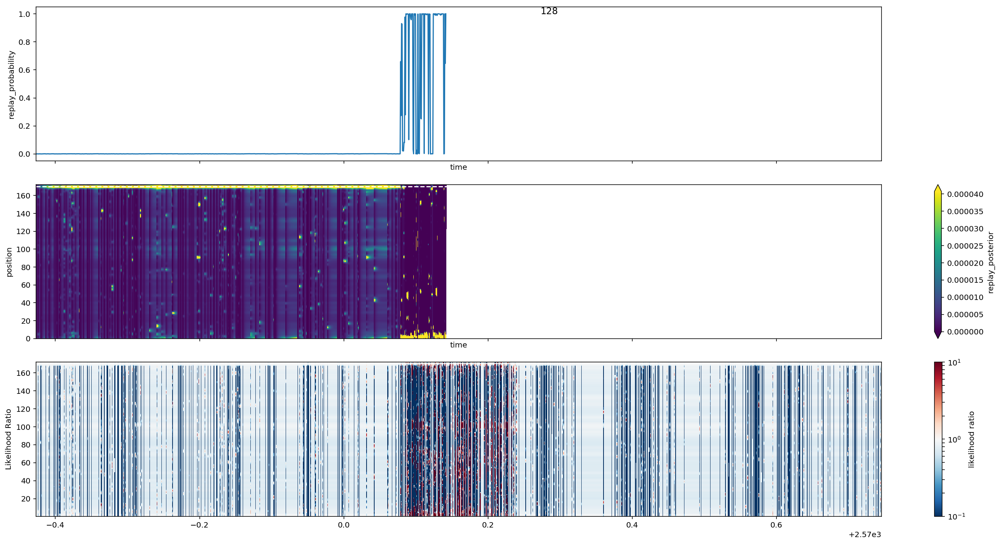

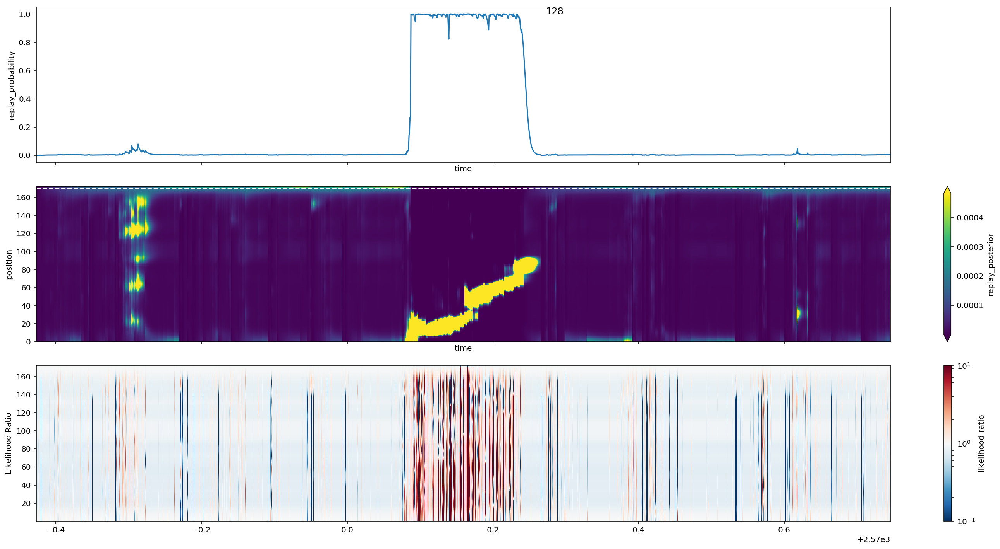

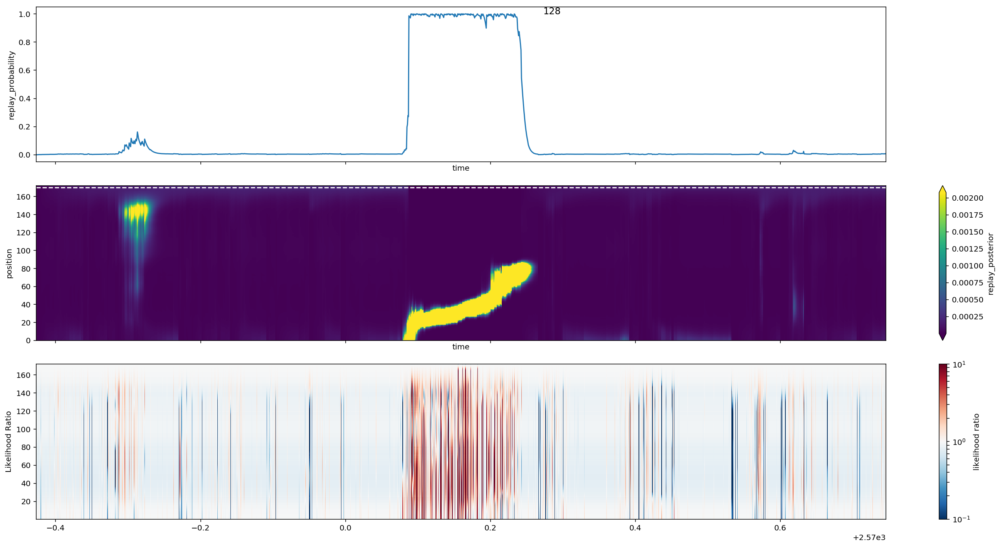

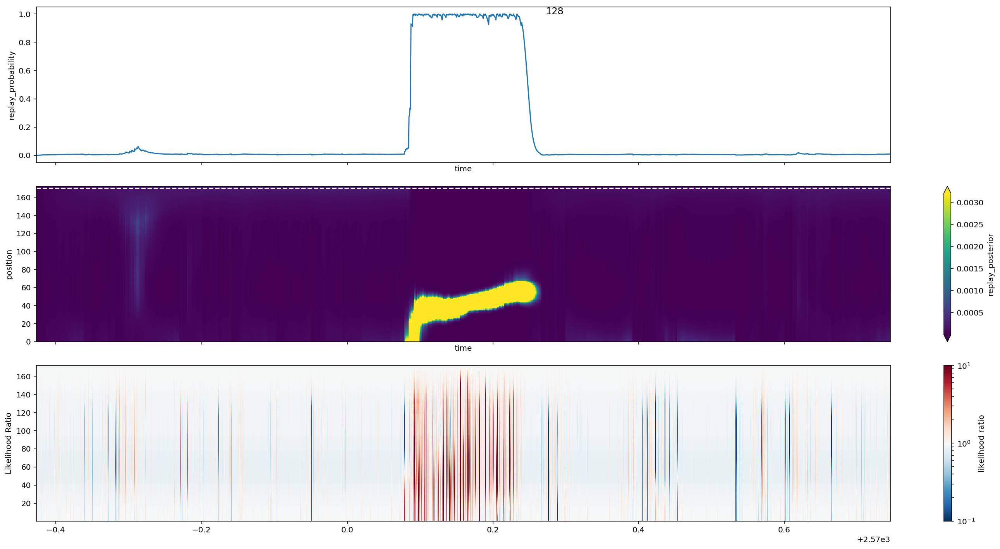

In [62]:
from sklearn.neighbors import KernelDensity

BANDWIDTHS = [1, 5, 10, 20]
min_time, max_time = 2570.073 - 0.5, 2570.246 + 0.5
sm = plt.cm.ScalarMappable()
sm.set_array([])

for bandwidth in BANDWIDTHS:
    ind = (time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)
    detector = ReplayDetector(
        replay_speed=16,
        multiunit_density_model=KernelDensity,
        multiunit_model_kwargs=dict(bandwidth=bandwidth, leaf_size=100000,
                                    rtol=1E-1))
    detector.fit(
        is_ripple, speed.values, linear_distance, multiunit=multiunit)
    results = detector.predict(
        speed.values[ind], linear_distance[ind], multiunit=multiunit[ind], time=time.total_seconds().values[ind],
        use_likelihoods=['multiunit'])
    ind = (results.time > min_time) & (results.time < max_time)

    fig, axes = plt.subplots(3, 1, figsize=(20, 10), sharex=True)

    results.replay_probability.sel(time=slice(min_time, max_time)).plot(x='time', ax=axes[0])
    plt.colorbar(sm, ax=axes[0]).ax.set_visible(False)
    c = results.replay_posterior.sel(time=slice(min_time, max_time)).plot(x='time', y='position', robust=True, ax=axes[1])
    axes[1].plot(results.time[ind], linear_distance[(time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)], linestyle='--', color='white');

    likelihood = results.likelihood.sel(time=slice(min_time, max_time))
    t, p = likelihood.time, likelihood.position
    t, p = np.meshgrid(t, p)
    cax = axes[2].pcolormesh(
        t, p, likelihood.values.T,
        norm=colors.LogNorm(1E-1, 1E1), cmap='RdBu_r')
    axes[2].set_ylabel('Likelihood Ratio')
    plt.colorbar(cax, ax=axes[2], label='likelihood ratio', orientation='vertical')
    plt.suptitle(bandwidth)
    plt.tight_layout()
    

INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:05<00:00,  3.39it/s]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:00<00:00, 1526.31it/s]
INFO:replay_identification.decoders:Predicting replay probability and density...
INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:19<00:00,  1.08s/it]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:00<00:00, 1304.74it/s]
INFO:replay_identificatio

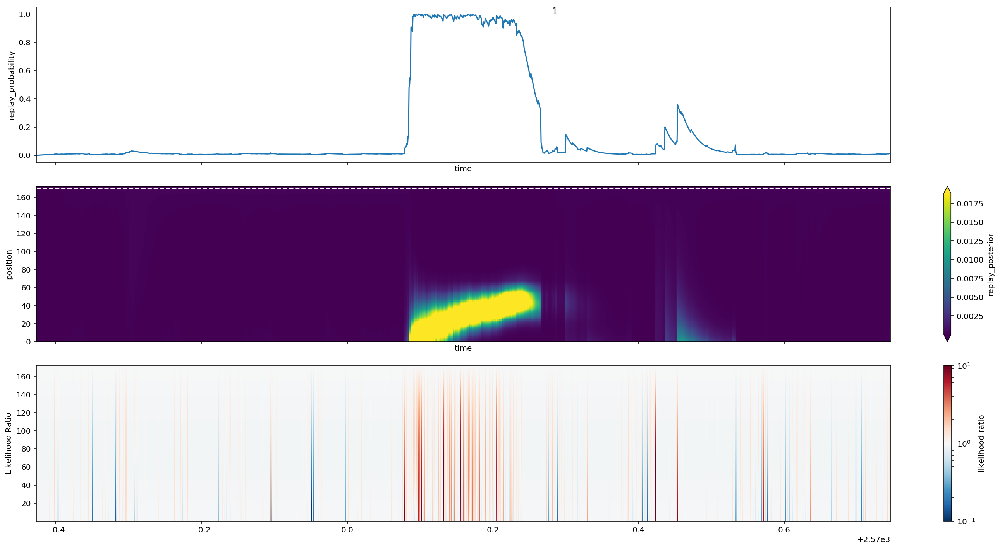

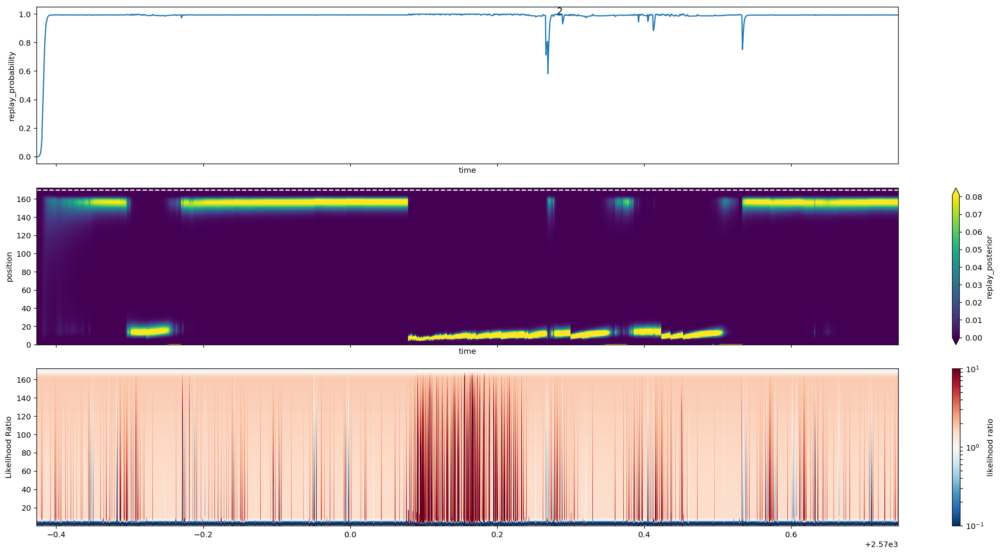

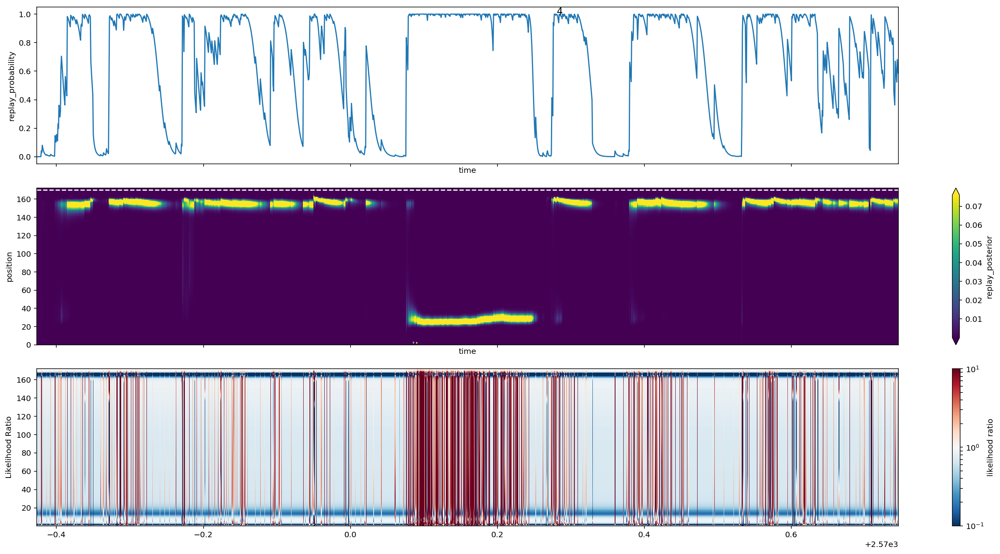

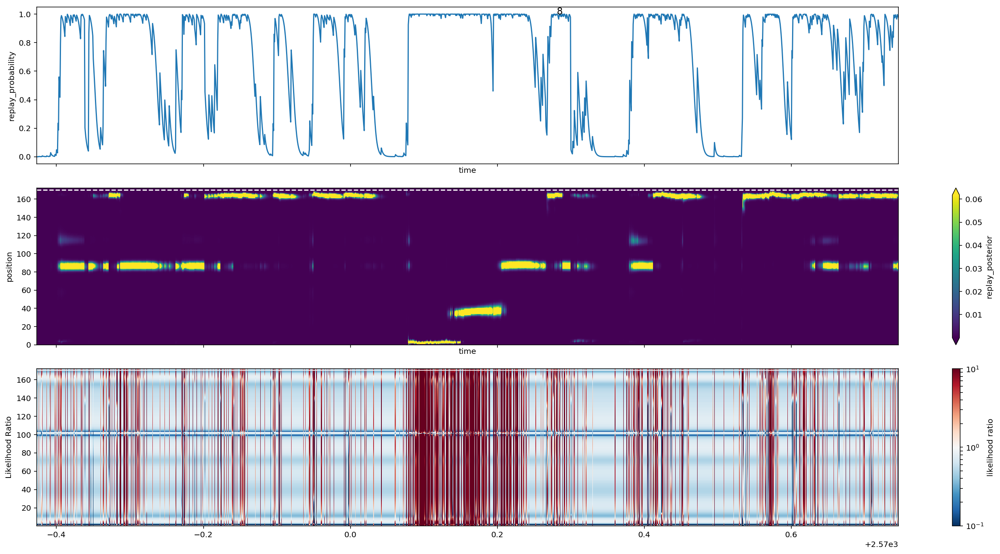

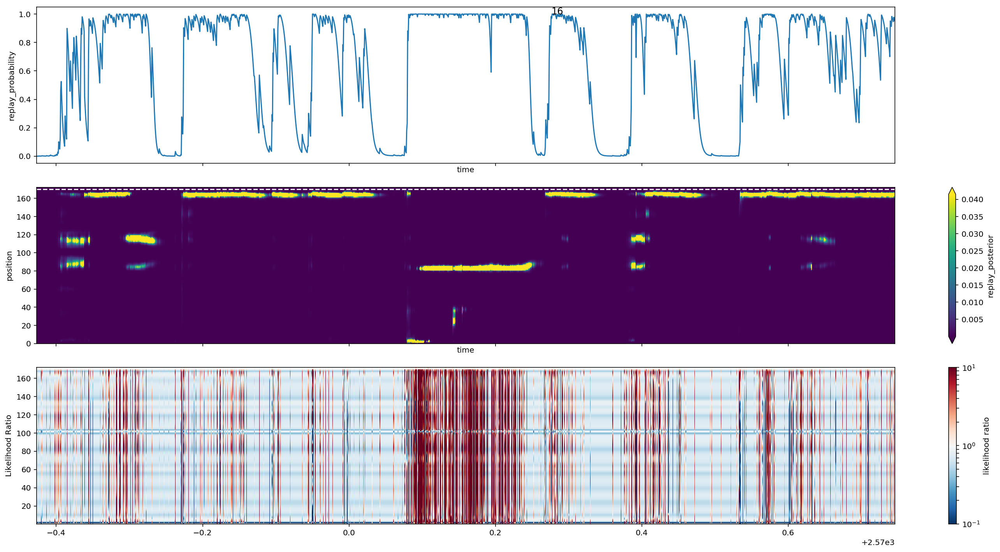

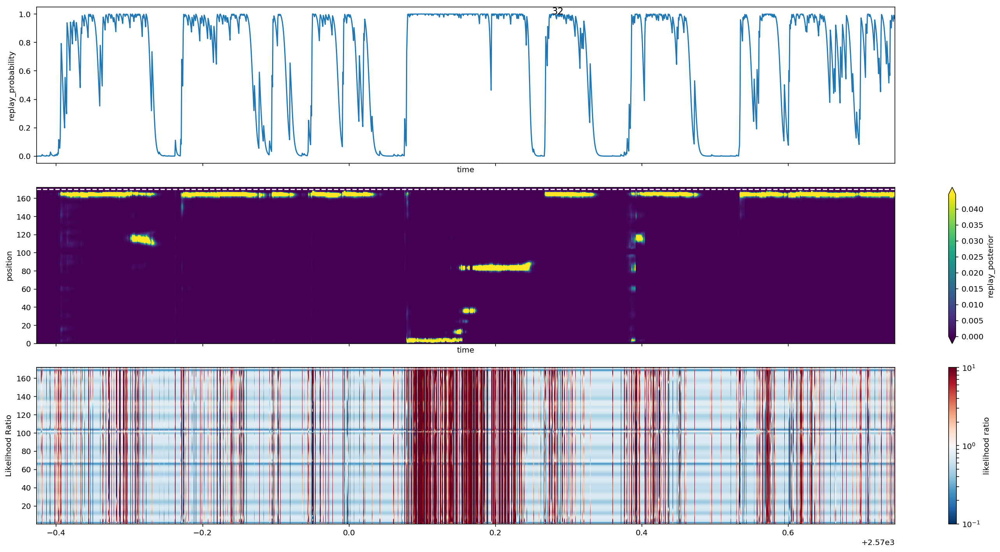

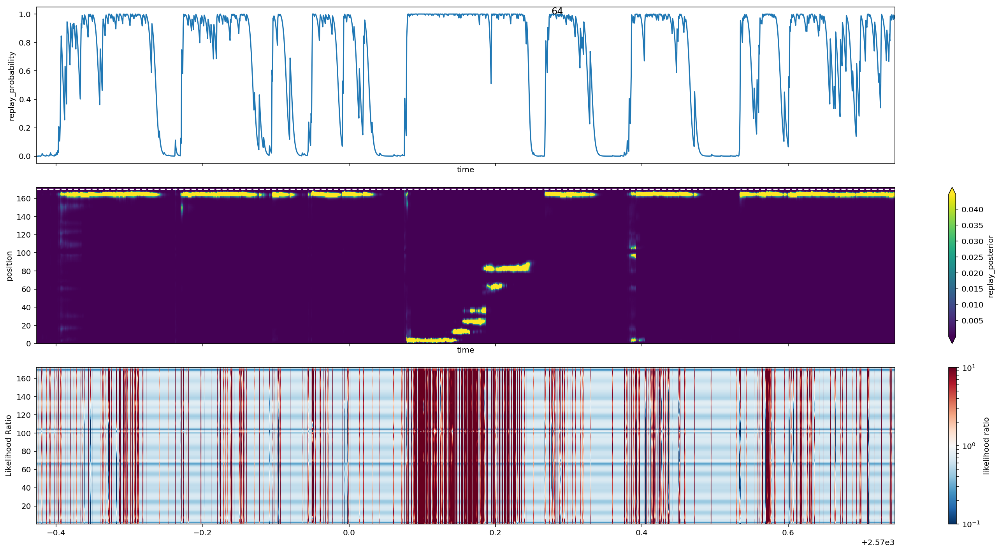

In [63]:
from sklearn.mixture import BayesianGaussianMixture

COMPONENTS = [1, 2, 4, 8, 16, 32, 64]
min_time, max_time = 2570.073 - 0.5, 2570.246 + 0.5
sm = plt.cm.ScalarMappable()
sm.set_array([])

for n_components in COMPONENTS:
    ind = (time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)
    detector = ReplayDetector(
        replay_speed=16,
        multiunit_density_model=BayesianGaussianMixture,
        multiunit_model_kwargs=dict(n_components=n_components))
    detector.fit(
        is_ripple, speed.values, linear_distance, multiunit=multiunit)
    results = detector.predict(
        speed.values[ind], linear_distance[ind], multiunit=multiunit[ind], time=time.total_seconds().values[ind],
        use_likelihoods=['multiunit'])
    ind = (results.time > min_time) & (results.time < max_time)

    fig, axes = plt.subplots(3, 1, figsize=(20, 10), sharex=True)

    results.replay_probability.sel(time=slice(min_time, max_time)).plot(x='time', ax=axes[0])
    plt.colorbar(sm, ax=axes[0]).ax.set_visible(False)
    c = results.replay_posterior.sel(time=slice(min_time, max_time)).plot(x='time', y='position', robust=True, ax=axes[1])
    axes[1].plot(results.time[ind], linear_distance[(time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)], linestyle='--', color='white');

    likelihood = results.likelihood.sel(time=slice(min_time, max_time))
    t, p = likelihood.time, likelihood.position
    t, p = np.meshgrid(t, p)
    cax = axes[2].pcolormesh(
        t, p, likelihood.values.T,
        norm=colors.LogNorm(1E-1, 1E1), cmap='RdBu_r')
    axes[2].set_ylabel('Likelihood Ratio')
    plt.colorbar(cax, ax=axes[2], label='likelihood ratio', orientation='vertical')
    plt.suptitle(n_components)
    plt.tight_layout()
    

INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:04<00:00,  3.68it/s]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:00<00:00, 1152.79it/s]
INFO:replay_identification.decoders:Predicting replay probability and density...
INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:13<00:00,  1.38it/s]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:00<00:00, 1131.08it/s]
INFO:replay_identificatio

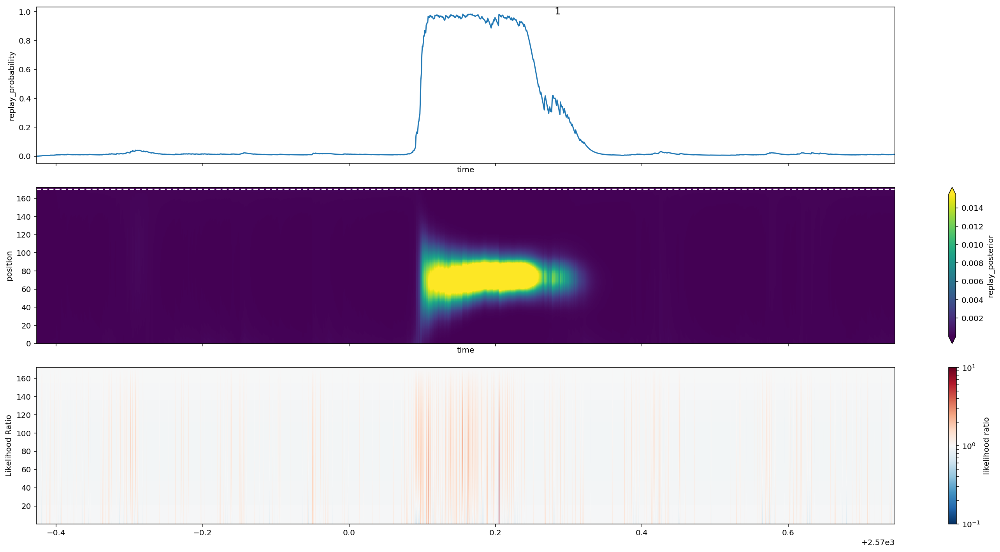

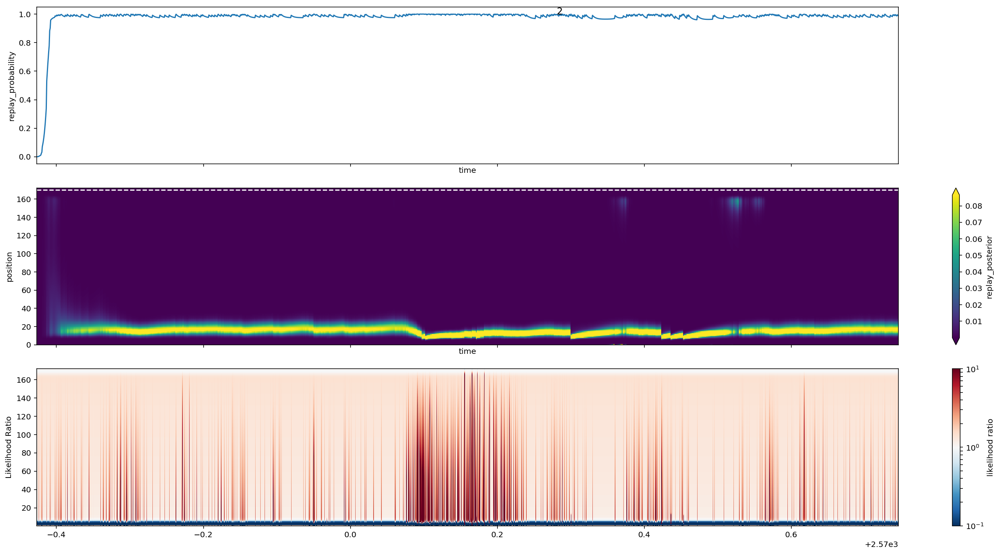

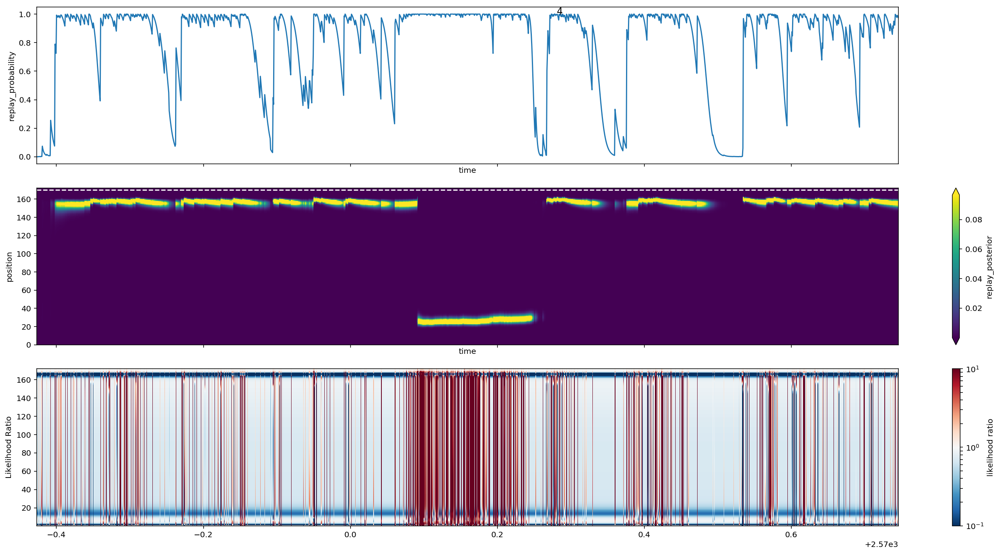

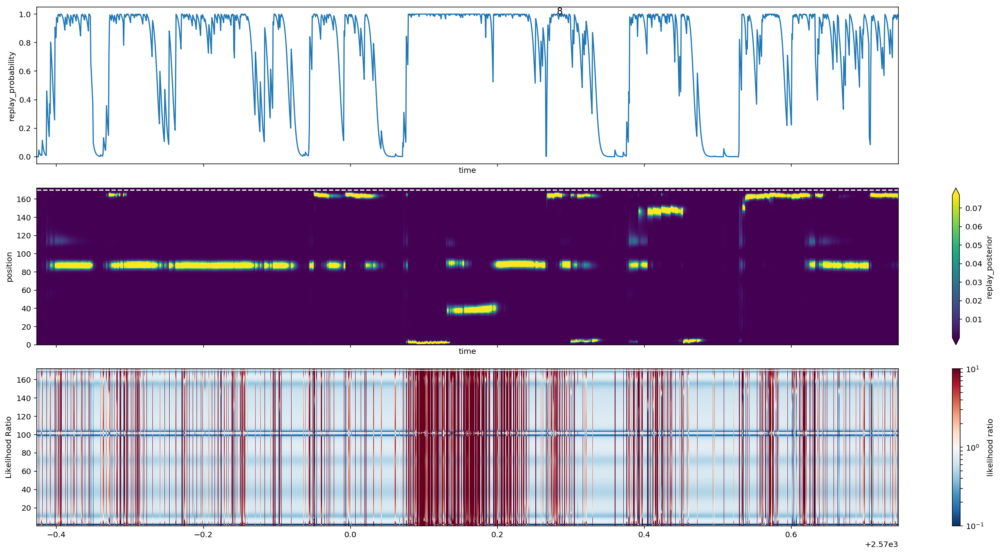

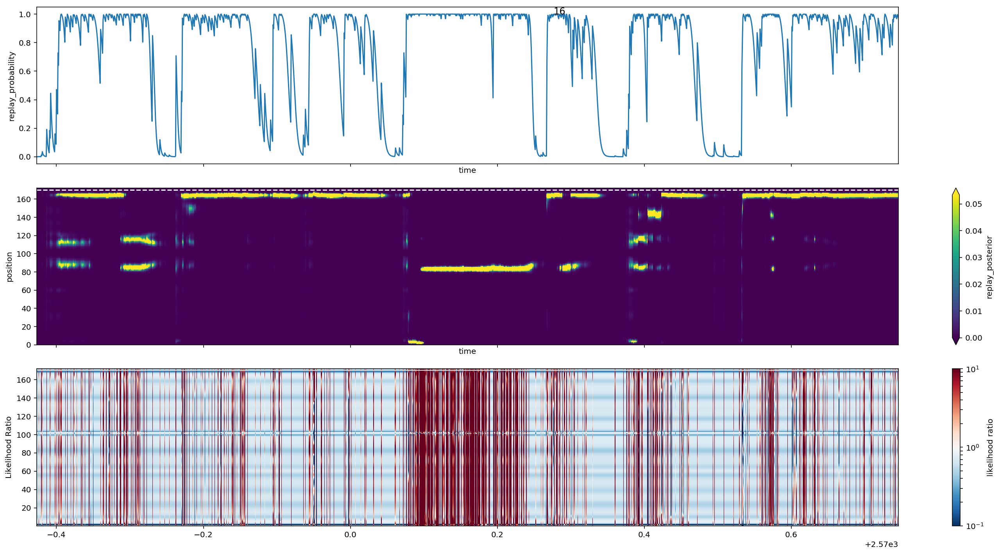

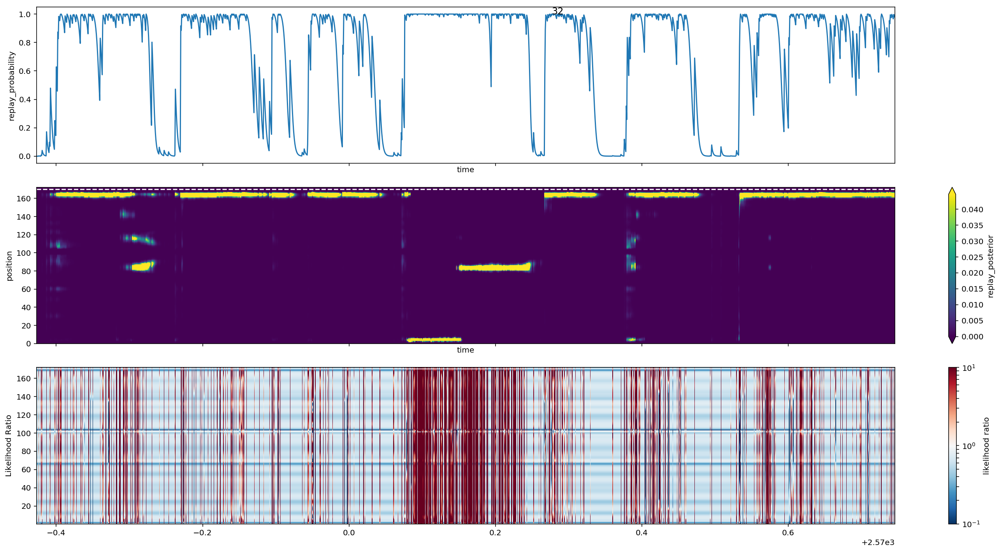

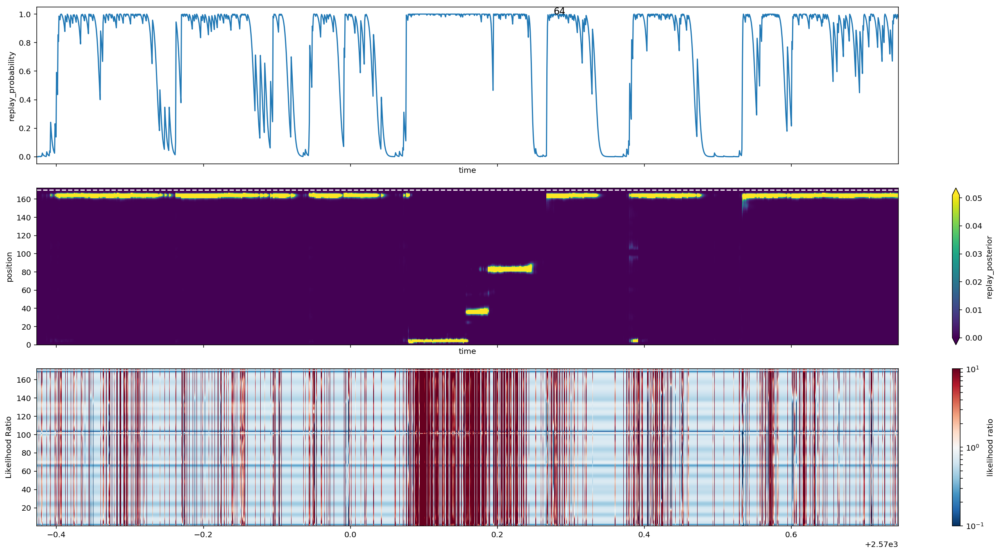

In [64]:
from sklearn.mixture import BayesianGaussianMixture

COMPONENTS = [1, 2, 4, 8, 16, 32, 64]
min_time, max_time = 2570.073 - 0.5, 2570.246 + 0.5
sm = plt.cm.ScalarMappable()
sm.set_array([])

for n_components in COMPONENTS:
    ind = (time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)
    detector = ReplayDetector(
        replay_speed=16,
        multiunit_density_model=BayesianGaussianMixture,
        multiunit_model_kwargs=dict(n_components=n_components, covariance_type='diag'))
    detector.fit(
        is_ripple, speed.values, linear_distance, multiunit=multiunit)
    results = detector.predict(
        speed.values[ind], linear_distance[ind], multiunit=multiunit[ind], time=time.total_seconds().values[ind],
        use_likelihoods=['multiunit'])
    ind = (results.time > min_time) & (results.time < max_time)

    fig, axes = plt.subplots(3, 1, figsize=(20, 10), sharex=True)

    results.replay_probability.sel(time=slice(min_time, max_time)).plot(x='time', ax=axes[0])
    plt.colorbar(sm, ax=axes[0]).ax.set_visible(False)
    c = results.replay_posterior.sel(time=slice(min_time, max_time)).plot(x='time', y='position', robust=True, ax=axes[1])
    axes[1].plot(results.time[ind], linear_distance[(time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)], linestyle='--', color='white');

    likelihood = results.likelihood.sel(time=slice(min_time, max_time))
    t, p = likelihood.time, likelihood.position
    t, p = np.meshgrid(t, p)
    cax = axes[2].pcolormesh(
        t, p, likelihood.values.T,
        norm=colors.LogNorm(1E-1, 1E1), cmap='RdBu_r')
    axes[2].set_ylabel('Likelihood Ratio')
    plt.colorbar(cax, ax=axes[2], label='likelihood ratio', orientation='vertical')
    plt.suptitle(n_components)
    plt.tight_layout()
    

INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:05<00:00,  3.02it/s]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:00<00:00, 1535.44it/s]
INFO:replay_identification.decoders:Predicting replay probability and density...
INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:17<00:00,  1.02it/s]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:00<00:00, 948.12it/s]
INFO:replay_identification

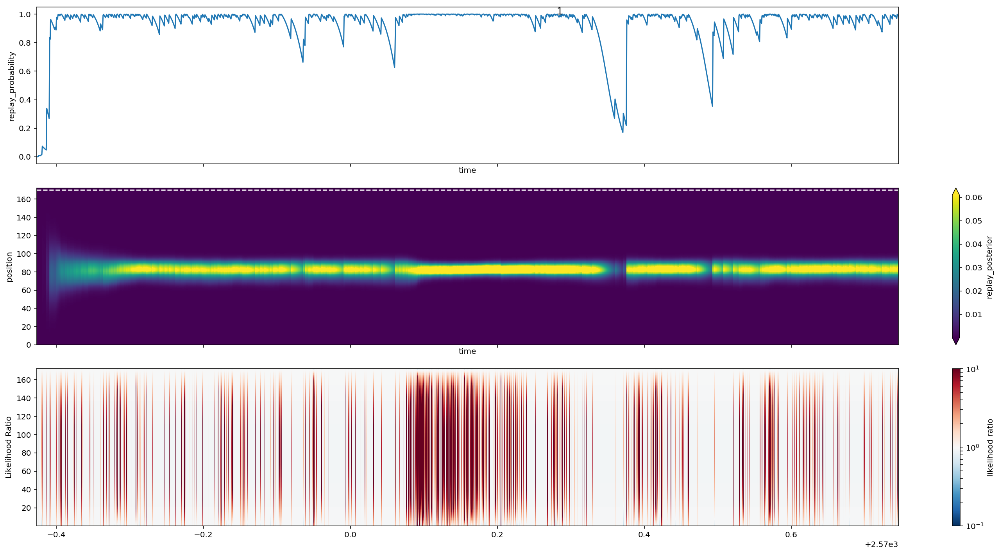

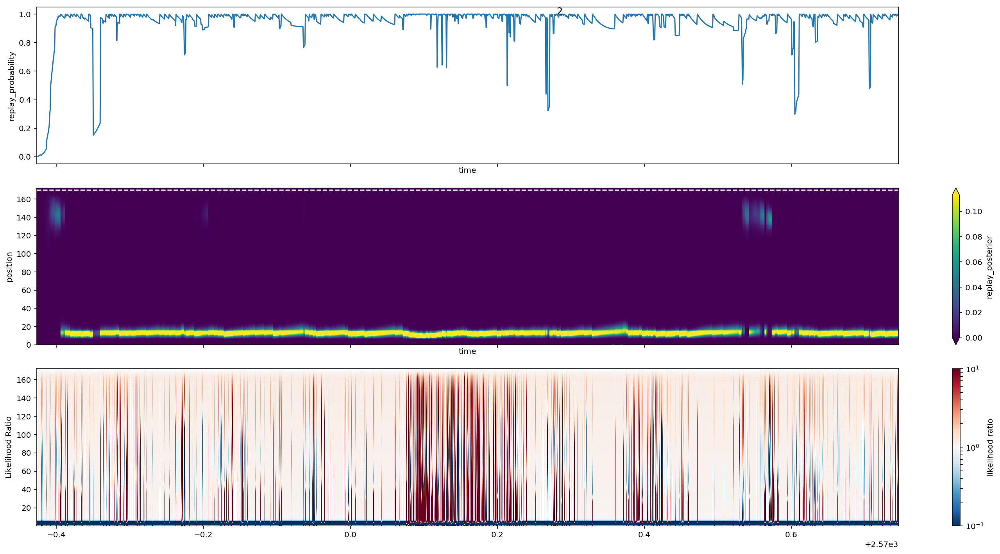

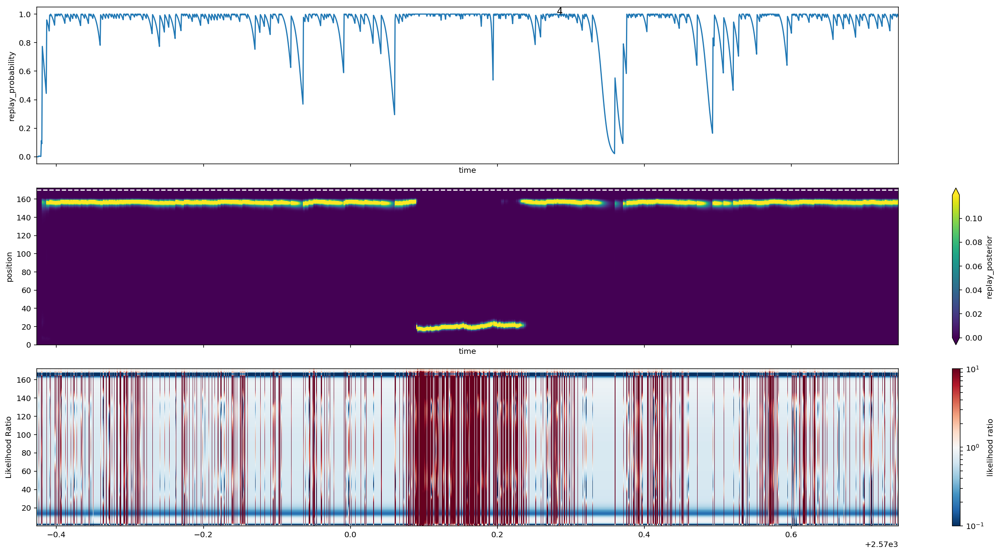

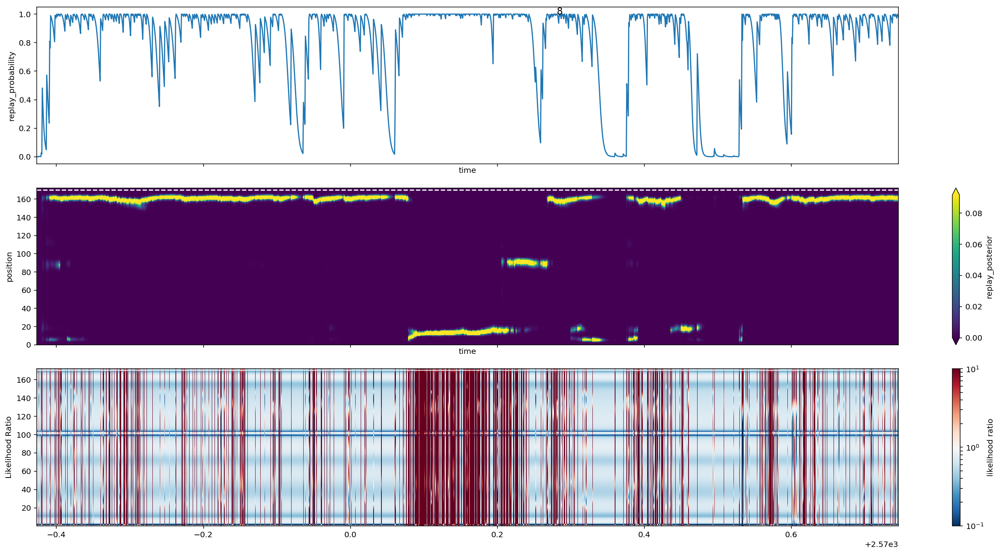

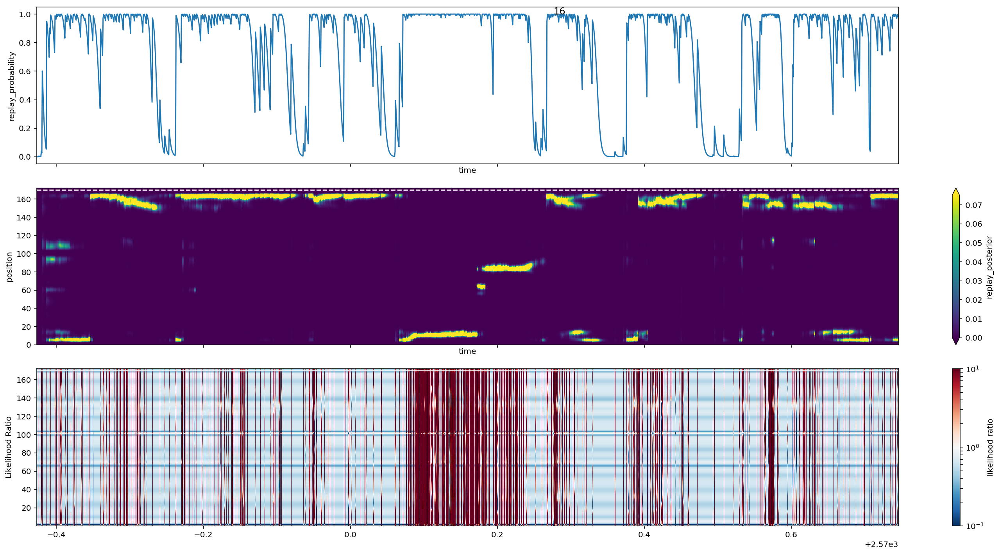

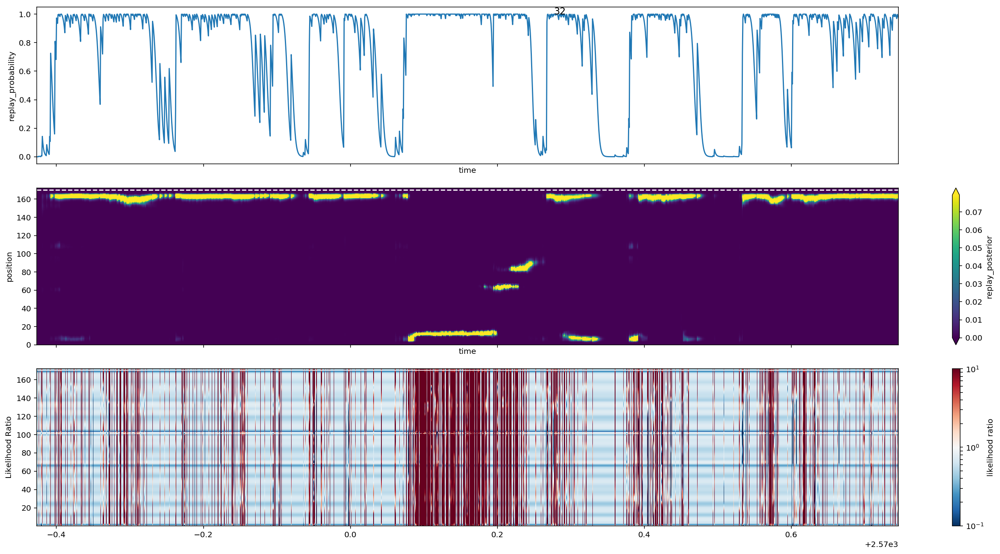

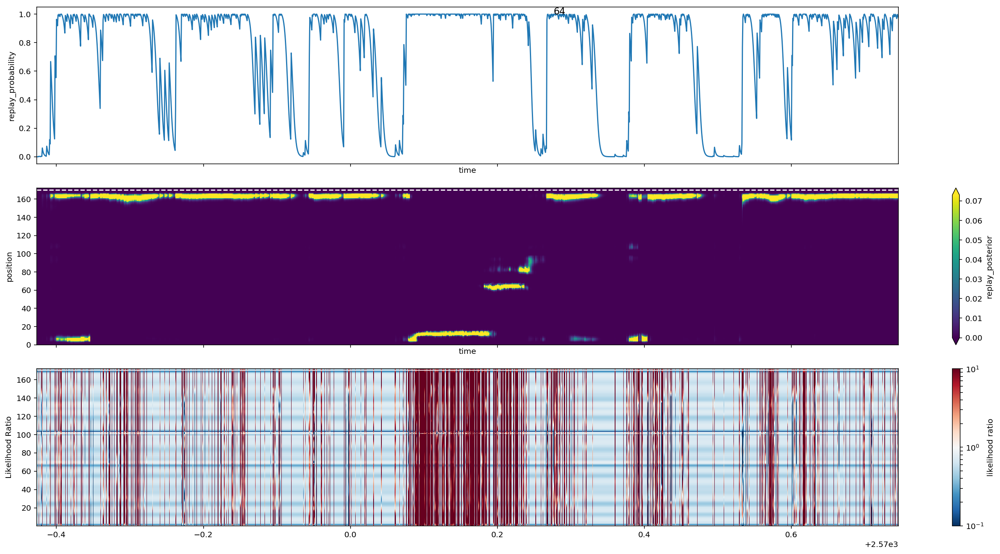

In [65]:
from sklearn.mixture import BayesianGaussianMixture

COMPONENTS = [1, 2, 4, 8, 16, 32, 64]
min_time, max_time = 2570.073 - 0.5, 2570.246 + 0.5
sm = plt.cm.ScalarMappable()
sm.set_array([])

for n_components in COMPONENTS:
    ind = (time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)
    detector = ReplayDetector(
        replay_speed=16,
        multiunit_density_model=BayesianGaussianMixture,
        multiunit_model_kwargs=dict(n_components=n_components, covariance_type='spherical'))
    detector.fit(
        is_ripple, speed.values, linear_distance, multiunit=multiunit)
    results = detector.predict(
        speed.values[ind], linear_distance[ind], multiunit=multiunit[ind], time=time.total_seconds().values[ind],
        use_likelihoods=['multiunit'])
    ind = (results.time > min_time) & (results.time < max_time)

    fig, axes = plt.subplots(3, 1, figsize=(20, 10), sharex=True)

    results.replay_probability.sel(time=slice(min_time, max_time)).plot(x='time', ax=axes[0])
    plt.colorbar(sm, ax=axes[0]).ax.set_visible(False)
    c = results.replay_posterior.sel(time=slice(min_time, max_time)).plot(x='time', y='position', robust=True, ax=axes[1])
    axes[1].plot(results.time[ind], linear_distance[(time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)], linestyle='--', color='white');

    likelihood = results.likelihood.sel(time=slice(min_time, max_time))
    t, p = likelihood.time, likelihood.position
    t, p = np.meshgrid(t, p)
    cax = axes[2].pcolormesh(
        t, p, likelihood.values.T,
        norm=colors.LogNorm(1E-1, 1E1), cmap='RdBu_r')
    axes[2].set_ylabel('Likelihood Ratio')
    plt.colorbar(cax, ax=axes[2], label='likelihood ratio', orientation='vertical')
    plt.suptitle(n_components)
    plt.tight_layout()
    

INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:05<00:00,  3.42it/s]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:38<00:00,  2.16s/it]
INFO:replay_identification.decoders:Predicting replay probability and density...
INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:08<00:00,  2.07it/s]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:47<00:00,  2.66s/it]
INFO:replay_identification.de

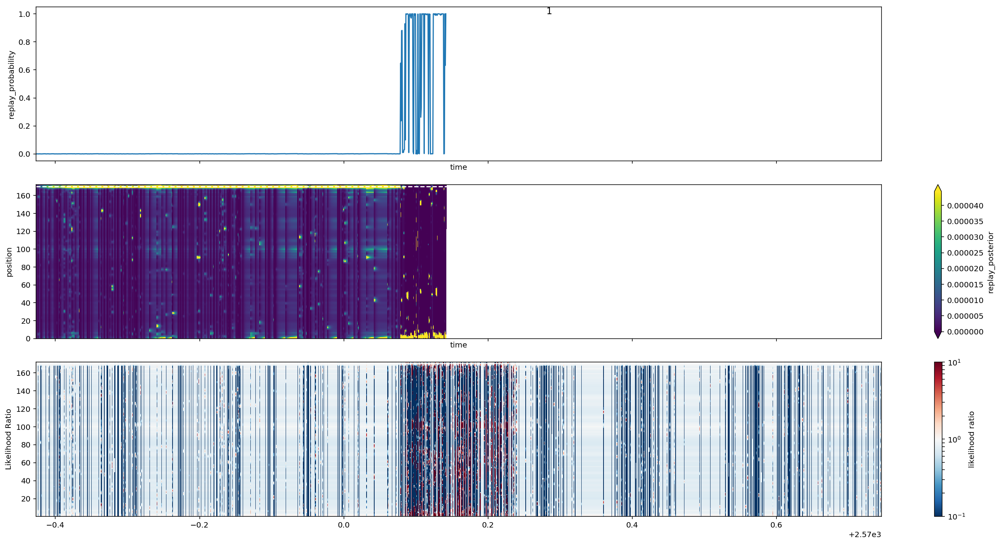

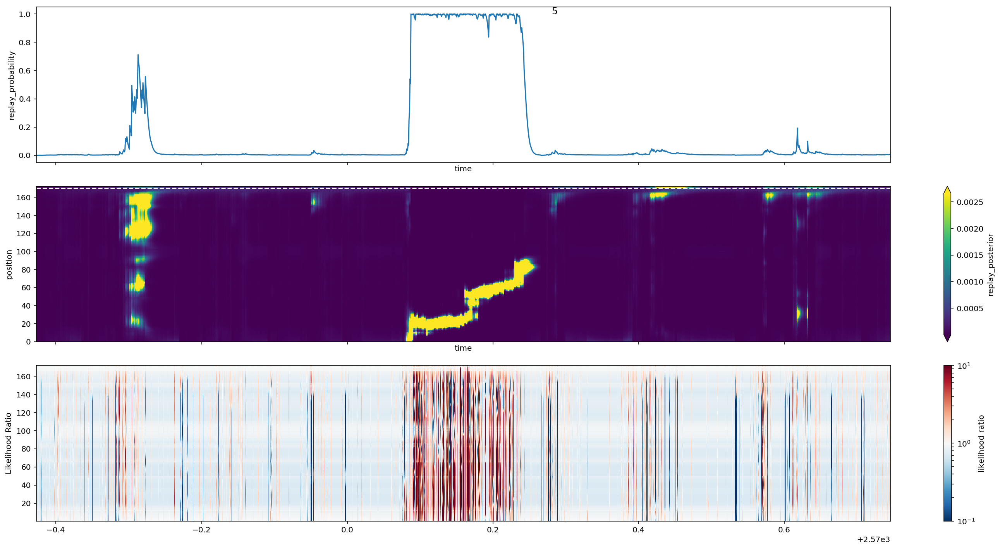

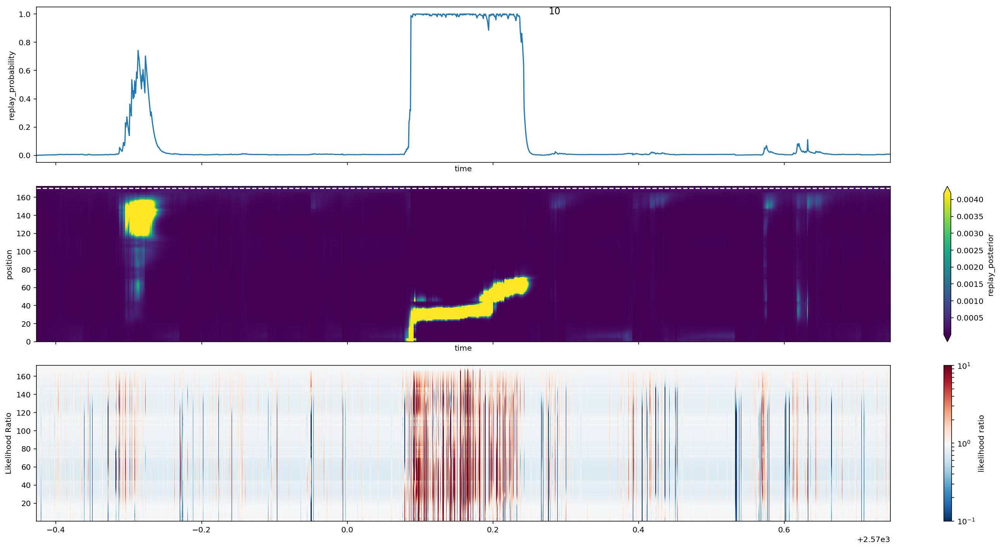

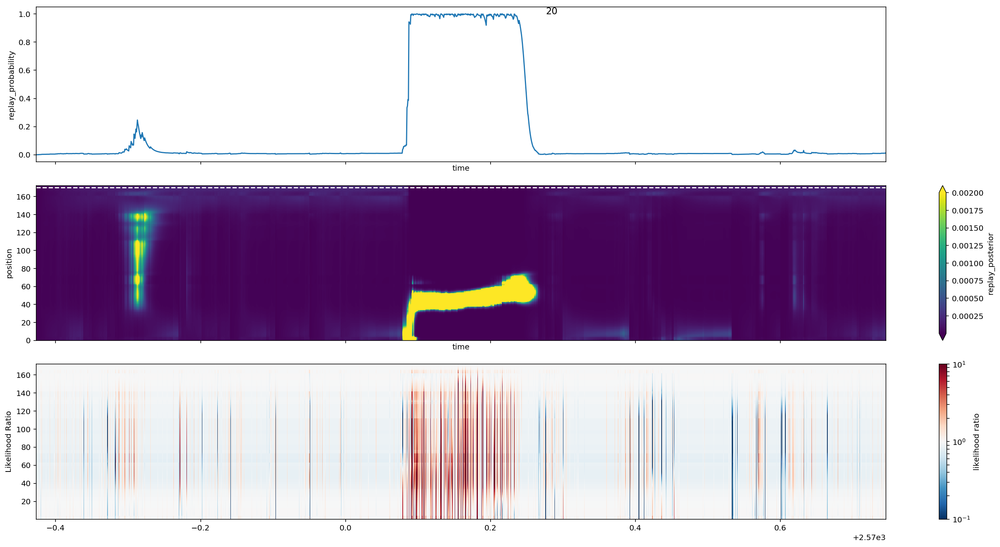

In [66]:
from sklearn.neighbors import KernelDensity

BANDWIDTHS = [1, 5, 10, 20]
min_time, max_time = 2570.073 - 0.5, 2570.246 + 0.5
sm = plt.cm.ScalarMappable()
sm.set_array([])

for bandwidth in BANDWIDTHS:
    ind = (time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)
    detector = ReplayDetector(
        replay_speed=16,
        multiunit_density_model=KernelDensity,
        multiunit_model_kwargs=dict(bandwidth=bandwidth, leaf_size=100000,
                                    rtol=1))
    detector.fit(
        is_ripple, speed.values, linear_distance, multiunit=multiunit)
    results = detector.predict(
        speed.values[ind], linear_distance[ind], multiunit=multiunit[ind], time=time.total_seconds().values[ind],
        use_likelihoods=['multiunit'])
    ind = (results.time > min_time) & (results.time < max_time)

    fig, axes = plt.subplots(3, 1, figsize=(20, 10), sharex=True)

    results.replay_probability.sel(time=slice(min_time, max_time)).plot(x='time', ax=axes[0])
    plt.colorbar(sm, ax=axes[0]).ax.set_visible(False)
    c = results.replay_posterior.sel(time=slice(min_time, max_time)).plot(x='time', y='position', robust=True, ax=axes[1])
    axes[1].plot(results.time[ind], linear_distance[(time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)], linestyle='--', color='white');

    likelihood = results.likelihood.sel(time=slice(min_time, max_time))
    t, p = likelihood.time, likelihood.position
    t, p = np.meshgrid(t, p)
    cax = axes[2].pcolormesh(
        t, p, likelihood.values.T,
        norm=colors.LogNorm(1E-1, 1E1), cmap='RdBu_r')
    axes[2].set_ylabel('Likelihood Ratio')
    plt.colorbar(cax, ax=axes[2], label='likelihood ratio', orientation='vertical')
    plt.suptitle(bandwidth)
    plt.tight_layout()
    

INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:08<00:00,  2.07it/s]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:36<00:00,  2.04s/it]
INFO:replay_identification.decoders:Predicting replay probability and density...
INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:10<00:00,  1.73it/s]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:47<00:00,  2.66s/it]
INFO:replay_identification.de

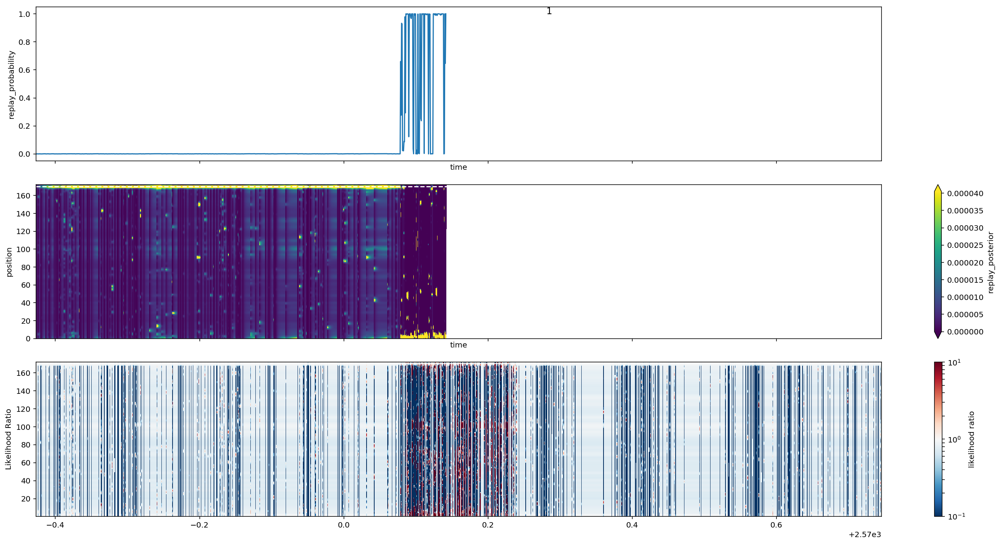

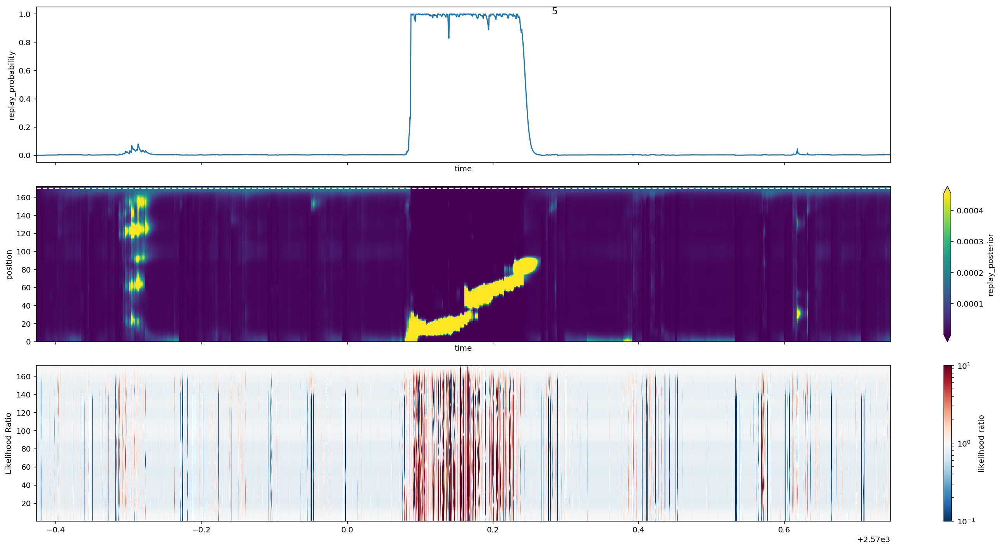

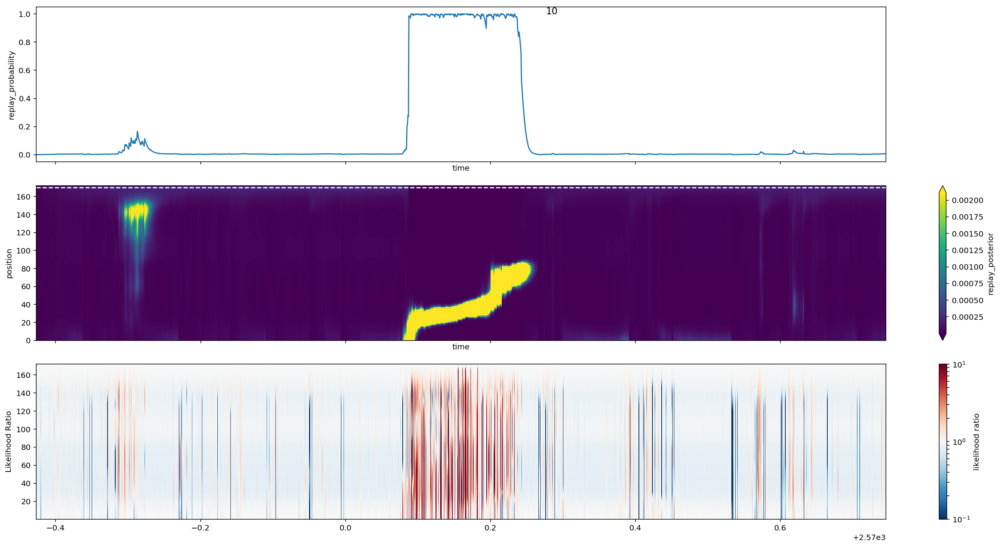

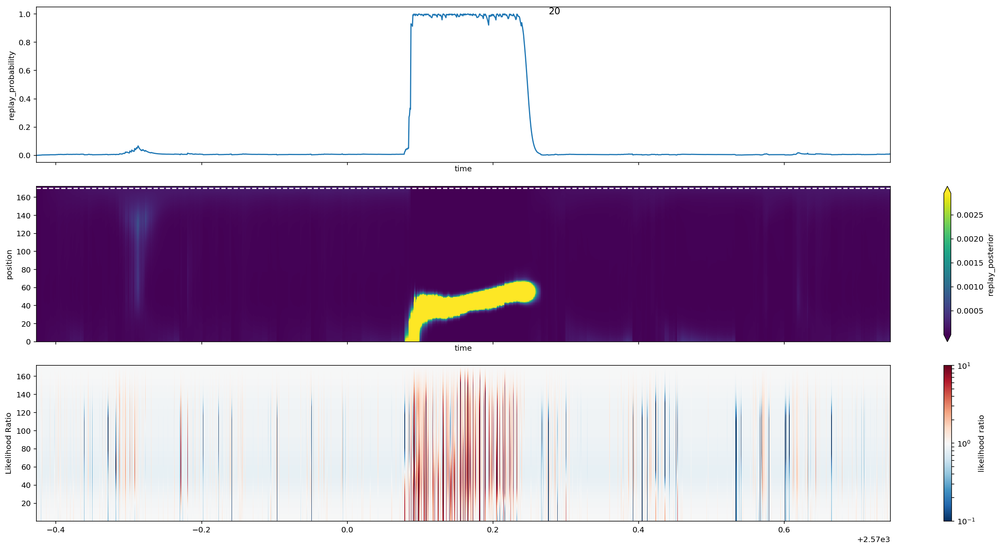

In [67]:
from sklearn.neighbors import KernelDensity

BANDWIDTHS = [1, 5, 10, 20]
min_time, max_time = 2570.073 - 0.5, 2570.246 + 0.5
sm = plt.cm.ScalarMappable()
sm.set_array([])

for bandwidth in BANDWIDTHS:
    ind = (time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)
    detector = ReplayDetector(
        replay_speed=16,
        multiunit_density_model=KernelDensity,
        multiunit_model_kwargs=dict(bandwidth=bandwidth, leaf_size=100000,
                                    rtol=1E-3))
    detector.fit(
        is_ripple, speed.values, linear_distance, multiunit=multiunit)
    results = detector.predict(
        speed.values[ind], linear_distance[ind], multiunit=multiunit[ind], time=time.total_seconds().values[ind],
        use_likelihoods=['multiunit'])
    ind = (results.time > min_time) & (results.time < max_time)

    fig, axes = plt.subplots(3, 1, figsize=(20, 10), sharex=True)

    results.replay_probability.sel(time=slice(min_time, max_time)).plot(x='time', ax=axes[0])
    plt.colorbar(sm, ax=axes[0]).ax.set_visible(False)
    c = results.replay_posterior.sel(time=slice(min_time, max_time)).plot(x='time', y='position', robust=True, ax=axes[1])
    axes[1].plot(results.time[ind], linear_distance[(time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)], linestyle='--', color='white');

    likelihood = results.likelihood.sel(time=slice(min_time, max_time))
    t, p = likelihood.time, likelihood.position
    t, p = np.meshgrid(t, p)
    cax = axes[2].pcolormesh(
        t, p, likelihood.values.T,
        norm=colors.LogNorm(1E-1, 1E1), cmap='RdBu_r')
    axes[2].set_ylabel('Likelihood Ratio')
    plt.colorbar(cax, ax=axes[2], label='likelihood ratio', orientation='vertical')
    plt.suptitle(bandwidth)
    plt.tight_layout()
    

INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:05<00:00,  3.19it/s]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:39<00:00,  2.17s/it]
INFO:replay_identification.decoders:Predicting replay probability and density...
INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [00:04<00:00,  4.13it/s]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:52<00:00,  2.91s/it]
INFO:replay_identification.de

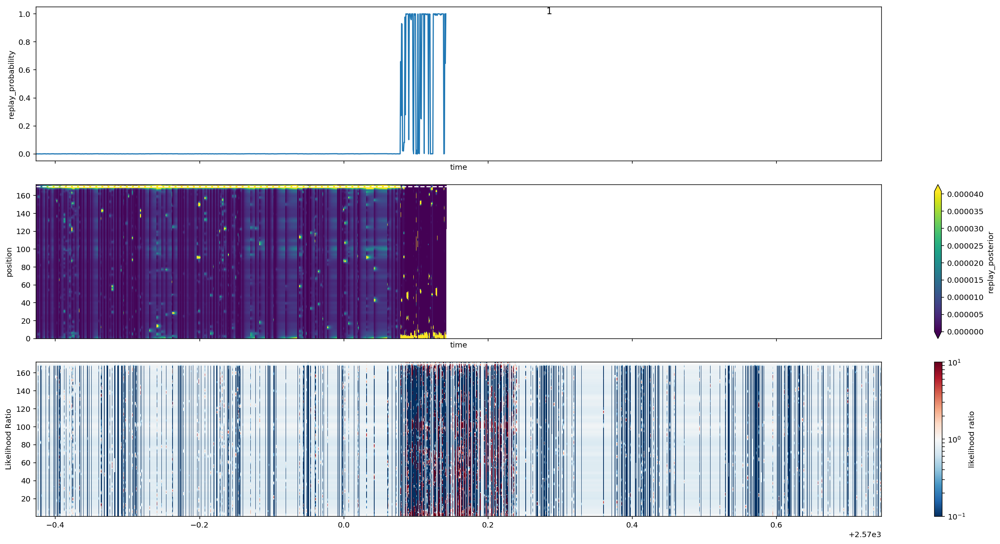

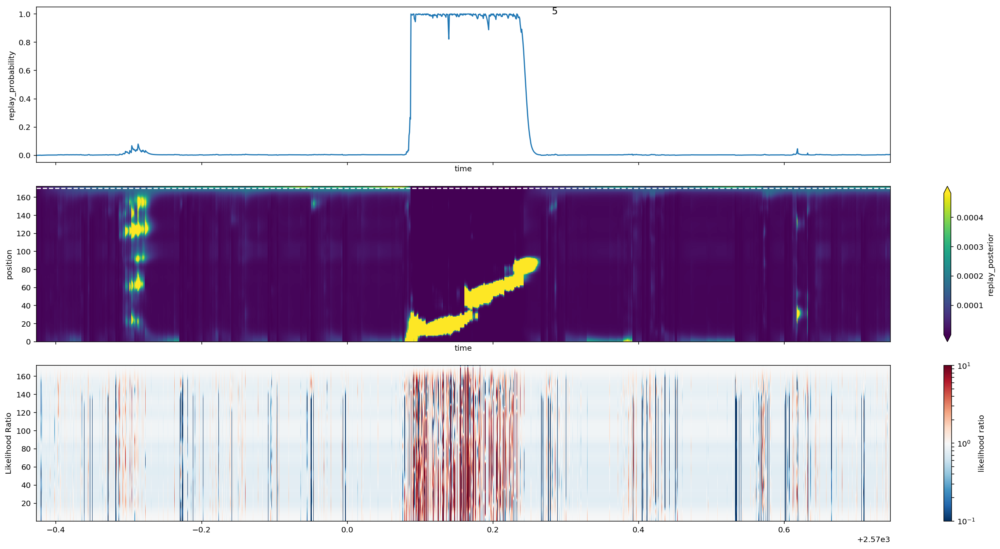

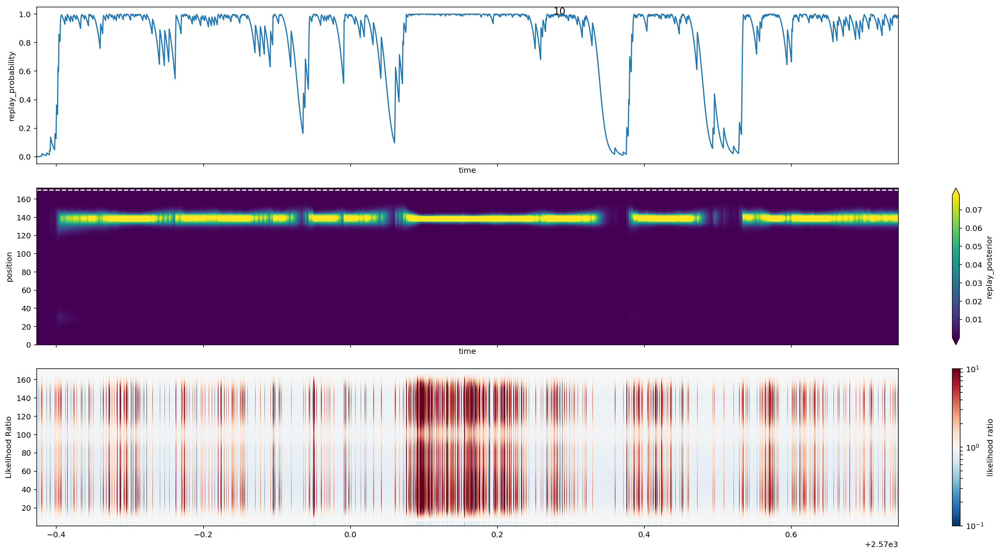

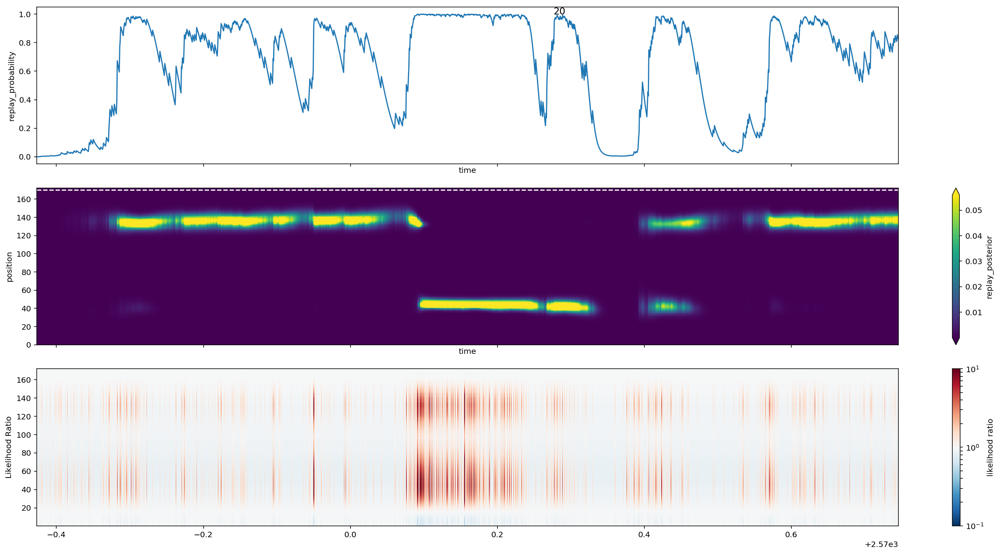

In [71]:
from sklearn.neighbors import KernelDensity

BANDWIDTHS = [1, 5, 10, 20]
min_time, max_time = 2570.073 - 0.5, 2570.246 + 0.5
sm = plt.cm.ScalarMappable()
sm.set_array([])

for bandwidth in BANDWIDTHS:
    ind = (time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)
    detector = ReplayDetector(
        replay_speed=16,
        multiunit_density_model=KernelDensity,
        multiunit_model_kwargs=dict(bandwidth=bandwidth, leaf_size=100000,
                                    rtol=1E-1, atol=1E-6))
    detector.fit(
        is_ripple, speed.values, linear_distance, multiunit=multiunit)
    results = detector.predict(
        speed.values[ind], linear_distance[ind], multiunit=multiunit[ind], time=time.total_seconds().values[ind],
        use_likelihoods=['multiunit'])
    ind = (results.time > min_time) & (results.time < max_time)

    fig, axes = plt.subplots(3, 1, figsize=(20, 10), sharex=True)

    results.replay_probability.sel(time=slice(min_time, max_time)).plot(x='time', ax=axes[0])
    plt.colorbar(sm, ax=axes[0]).ax.set_visible(False)
    c = results.replay_posterior.sel(time=slice(min_time, max_time)).plot(x='time', y='position', robust=True, ax=axes[1])
    axes[1].plot(results.time[ind], linear_distance[(time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)], linestyle='--', color='white');

    likelihood = results.likelihood.sel(time=slice(min_time, max_time))
    t, p = likelihood.time, likelihood.position
    t, p = np.meshgrid(t, p)
    cax = axes[2].pcolormesh(
        t, p, likelihood.values.T,
        norm=colors.LogNorm(1E-1, 1E1), cmap='RdBu_r')
    axes[2].set_ylabel('Likelihood Ratio')
    plt.colorbar(cax, ax=axes[2], label='likelihood ratio', orientation='vertical')
    plt.suptitle(bandwidth)
    plt.tight_layout()
    

INFO:replay_identification.decoders:Fitting speed model...
INFO:replay_identification.decoders:Fitting multiunit model...
electrodes: 100%|██████████| 18/18 [03:55<00:00, 13.06s/it]
INFO:replay_identification.decoders:Fitting movement state transition...
INFO:replay_identification.decoders:Fitting replay state transition...
INFO:replay_identification.decoders:Predicting multiunit likelihood...
100%|██████████| 18/18 [00:00<00:00, 563.38it/s]
INFO:replay_identification.decoders:Predicting replay probability and density...


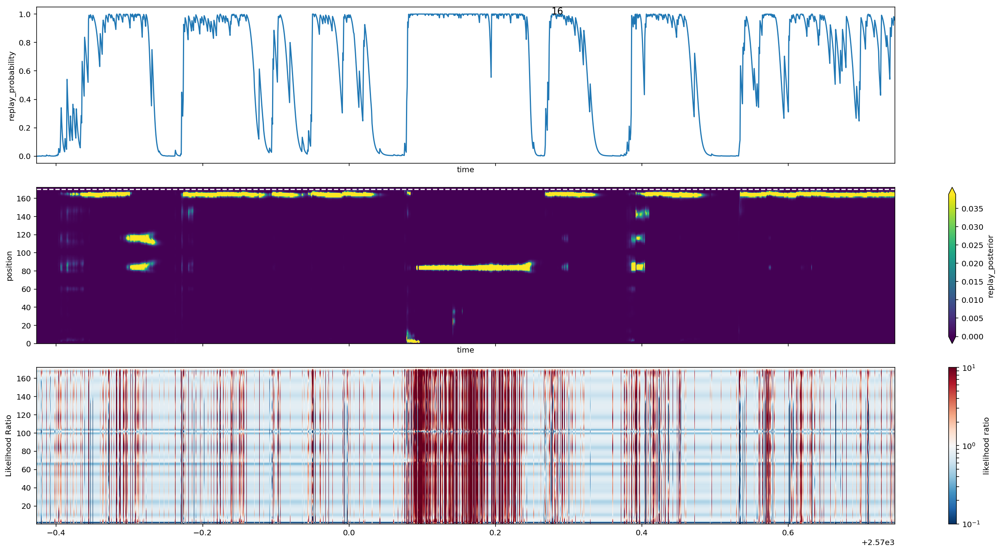

In [75]:
from sklearn.mixture import BayesianGaussianMixture

COMPONENTS = [16]
min_time, max_time = 2570.073 - 0.5, 2570.246 + 0.5
sm = plt.cm.ScalarMappable()
sm.set_array([])

for n_components in COMPONENTS:
    ind = (time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)
    detector = ReplayDetector(
        replay_speed=16,
        multiunit_density_model=BayesianGaussianMixture,
        multiunit_model_kwargs=dict(n_components=n_components, weight_concentration_prior=1E3))
    detector.fit(
        is_ripple, speed.values, linear_distance, multiunit=multiunit)
    results = detector.predict(
        speed.values[ind], linear_distance[ind], multiunit=multiunit[ind], time=time.total_seconds().values[ind],
        use_likelihoods=['multiunit'])
    ind = (results.time > min_time) & (results.time < max_time)

    fig, axes = plt.subplots(3, 1, figsize=(20, 10), sharex=True)

    results.replay_probability.sel(time=slice(min_time, max_time)).plot(x='time', ax=axes[0])
    plt.colorbar(sm, ax=axes[0]).ax.set_visible(False)
    c = results.replay_posterior.sel(time=slice(min_time, max_time)).plot(x='time', y='position', robust=True, ax=axes[1])
    axes[1].plot(results.time[ind], linear_distance[(time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)], linestyle='--', color='white');

    likelihood = results.likelihood.sel(time=slice(min_time, max_time))
    t, p = likelihood.time, likelihood.position
    t, p = np.meshgrid(t, p)
    cax = axes[2].pcolormesh(
        t, p, likelihood.values.T,
        norm=colors.LogNorm(1E-1, 1E1), cmap='RdBu_r')
    axes[2].set_ylabel('Likelihood Ratio')
    plt.colorbar(cax, ax=axes[2], label='likelihood ratio', orientation='vertical')
    plt.suptitle(n_components)
    plt.tight_layout()
    

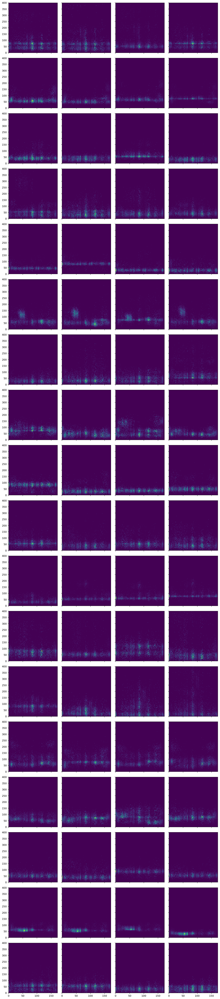

In [98]:
detector.plot_fitted_multiunit_model(
    is_histogram=True, sampling_frequency=sampling_frequency);

In [ ]:
ind = (time.total_seconds().values > min_time) & (time.total_seconds().values < max_time)
detector = ReplayDetector(
    replay_speed=16,
    multiunit_density_model=KernelDensity,
    multiunit_model_kwargs=dict(bandwidth=20, leaf_size=100000,
                                rtol=1E-1))
detector.fit(
    is_ripple, speed.values, linear_distance, multiunit=multiunit)
detector.plot_fitted_multiunit_model();